Script that looks at merging the atlas's smaller regions into larger regions, according to the AAL3 literature

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os
from sklearn.mixture import GaussianMixture
from pySuStaIn import ZscoreSustain, MixtureSustain
import numpy as np

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
data_dir = 'data'

df = pd.read_csv(os.path.join(data_dir, 'huw_whole_df.csv'), index_col = 0) # df with the SUVr's

suvr_cols_original = [col for col in df.columns if col.startswith("SUVr")] # original col names starting with SUVr_

suvr_cols_new = [col.replace('SUVr_', '') for col in suvr_cols_original] # new names without the SUVr, makes lif a bit easier and useful when wofking with the masks

In [3]:
df

,PTID,TAU_bl,PTAU_bl,ABETA_bl,EXAMDATE,EXAMDATE_bl,DX_bl,DX,AGE,PTGENDER,...,SUVr_Vermis_1_2.nii,SUVr_Vermis_3.nii,SUVr_Vermis_4_5.nii,SUVr_Vermis_6.nii,SUVr_Vermis_7.nii,SUVr_Vermis_8.nii,SUVr_Vermis_9.nii,SUVr_Vermis_10.nii,SUVr_VTA_L.nii,SUVr_VTA_R.nii
1,100_S_5280,101.20,10.08,731.8,2015-09-29,2013-09-17,3,2,67.5,0,...,0.003369,0.011351,0.030880,0.018253,0.009289,0.011917,0.008881,0.006231,0.000712,0.000659
2,027_S_5277,324.80,34.39,780.3,2015-08-31,2013-08-28,3,2,71.8,1,...,0.003325,0.011246,0.029007,0.016903,0.009108,0.012666,0.008033,0.006029,0.000770,0.000699
3,135_S_5275,490.40,53.18,832.7,2014-02-25,2013-08-27,0,0,78.0,1,...,0.003402,0.011694,0.033622,0.019224,0.010413,0.012902,0.007799,0.005730,0.000804,0.000760
4,135_S_5269,108.20,10.55,590.4,2015-09-01,2013-08-20,3,2,64.9,0,...,0.003367,0.011986,0.034076,0.019834,0.010011,0.012782,0.009789,0.006613,0.000748,0.000675
5,007_S_5265,247.10,24.78,466.1,2015-08-25,2013-08-12,3,2,75.1,1,...,0.002935,0.009448,0.028740,0.017897,0.009361,0.012595,0.008533,0.005170,0.000675,0.000675
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
542,127_S_5266,279.90,24.28,1700.0,2015-08-06,2013-08-15,3,2,65.9,0,...,0.003873,0.012135,0.034131,0.018864,0.008398,0.011478,0.009674,0.007555,0.000818,0.000764
543,053_S_5272,305.00,25.05,1700.0,2015-09-15,2013-09-04,3,2,69.9,1,...,0.003308,0.010313,0.029413,0.016943,0.008936,0.011930,0.008579,0.006243,0.000678,0.000581
544,053_S_5287,268.40,26.11,1700.0,2015-09-30,2013-09-18,3,2,78.9,1,...,0.003723,0.011469,0.026939,0.015693,0.008374,0.011329,0.008016,0.006976,0.000753,0.000723
545,027_S_5288,300.10,26.59,1700.0,2015-09-24,2013-09-25,3,2,81.9,1,...,0.003486,0.011536,0.031103,0.017387,0.008620,0.010525,0.007063,0.005713,0.000815,0.000768


In [4]:
dictionary = dict(zip(suvr_cols_original, suvr_cols_new)) # dict to use as a mapper in pd.rename
dictionary

{'SUVr_ACC_pre_L.nii': 'ACC_pre_L.nii',
 'SUVr_ACC_pre_R.nii': 'ACC_pre_R.nii',
 'SUVr_ACC_sub_L.nii': 'ACC_sub_L.nii',
 'SUVr_ACC_sub_R.nii': 'ACC_sub_R.nii',
 'SUVr_ACC_sup_L.nii': 'ACC_sup_L.nii',
 'SUVr_ACC_sup_R.nii': 'ACC_sup_R.nii',
 'SUVr_Amygdala_L.nii': 'Amygdala_L.nii',
 'SUVr_Amygdala_R.nii': 'Amygdala_R.nii',
 'SUVr_Angular_L.nii': 'Angular_L.nii',
 'SUVr_Angular_R.nii': 'Angular_R.nii',
 'SUVr_Calcarine_L.nii': 'Calcarine_L.nii',
 'SUVr_Calcarine_R.nii': 'Calcarine_R.nii',
 'SUVr_Caudate_L.nii': 'Caudate_L.nii',
 'SUVr_Caudate_R.nii': 'Caudate_R.nii',
 'SUVr_Cerebellum_3_L.nii': 'Cerebellum_3_L.nii',
 'SUVr_Cerebellum_3_R.nii': 'Cerebellum_3_R.nii',
 'SUVr_Cerebellum_4_5_L.nii': 'Cerebellum_4_5_L.nii',
 'SUVr_Cerebellum_4_5_R.nii': 'Cerebellum_4_5_R.nii',
 'SUVr_Cerebellum_6_L.nii': 'Cerebellum_6_L.nii',
 'SUVr_Cerebellum_6_R.nii': 'Cerebellum_6_R.nii',
 'SUVr_Cerebellum_7b_L.nii': 'Cerebellum_7b_L.nii',
 'SUVr_Cerebellum_7b_R.nii': 'Cerebellum_7b_R.nii',
 'SUVr_Cerebellu

In [5]:
df.rename(columns = dictionary, inplace=True)

In [6]:
# like regions grouped together.
region_groups = {
    "ACC": [
        "ACC_pre_L.nii", "ACC_pre_R.nii",
        "ACC_sub_L.nii", "ACC_sub_R.nii",
        "ACC_sup_L.nii", "ACC_sup_R.nii",
    ],
    "Amygdala": ["Amygdala_L.nii", "Amygdala_R.nii"],
    "Angular": ["Angular_L.nii", "Angular_R.nii"],
    "Calcarine": ["Calcarine_L.nii", "Calcarine_R.nii"],
    "Caudate": ["Caudate_L.nii", "Caudate_R.nii"],
    "Cerebellum": [
        "Cerebellum_3_L.nii", "Cerebellum_3_R.nii",
        "Cerebellum_4_5_L.nii", "Cerebellum_4_5_R.nii",
        "Cerebellum_6_L.nii", "Cerebellum_6_R.nii",
        "Cerebellum_7b_L.nii", "Cerebellum_7b_R.nii",
        "Cerebellum_8_L.nii", "Cerebellum_8_R.nii",
        "Cerebellum_9_L.nii", "Cerebellum_9_R.nii",
        "Cerebellum_10_L.nii", "Cerebellum_10_R.nii",
        "Cerebellum_Crus1_L.nii", "Cerebellum_Crus1_R.nii",
        "Cerebellum_Crus2_L.nii", "Cerebellum_Crus2_R.nii",
    ],
    "Cingulate": [
        "Cingulate_Mid_L.nii", "Cingulate_Mid_R.nii",
        "Cingulate_Post_L.nii", "Cingulate_Post_R.nii",
    ],
    "Cuneus": ["Cuneus_L.nii", "Cuneus_R.nii"],
    "Frontal": [
        "Frontal_Inf_Oper_L.nii", "Frontal_Inf_Oper_R.nii",
        "Frontal_Inf_Orb_2_L.nii", "Frontal_Inf_Orb_2_R.nii",
        "Frontal_Inf_Tri_L.nii", "Frontal_Inf_Tri_R.nii",
        "Frontal_Med_Orb_L.nii", "Frontal_Med_Orb_R.nii",
        "Frontal_Mid_2_L.nii", "Frontal_Mid_2_R.nii",
        "Frontal_Sup_2_L.nii", "Frontal_Sup_2_R.nii",
        "Frontal_Sup_Medial_L.nii", "Frontal_Sup_Medial_R.nii",
    ],
    "Fusiform": ["Fusiform_L.nii", "Fusiform_R.nii"],
    "Heschl": ["Heschl_L.nii", "Heschl_R.nii"],
    "Hippocampus": ["Hippocampus_L.nii", "Hippocampus_R.nii"],
    "Insula": ["Insula_L.nii", "Insula_R.nii"],
    "LC": ["LC_L.nii", "LC_R.nii"],
    "Lingual": ["Lingual_L.nii", "Lingual_R.nii"],
    "Nucleus_Accumbens": ["N_Acc_L.nii", "N_Acc_R.nii"],
    "Occipital": [
        "Occipital_Inf_L.nii", "Occipital_Inf_R.nii",
        "Occipital_Mid_L.nii", "Occipital_Mid_R.nii",
        "Occipital_Sup_L.nii", "Occipital_Sup_R.nii",
    ],
    "OFC": [
        "OFCant_L.nii", "OFCant_R.nii",
        "OFClat_L.nii", "OFClat_R.nii",
        "OFCmed_L.nii", "OFCmed_R.nii",
        "OFCpost_L.nii", "OFCpost_R.nii",
    ],
    "Olfactory": ["Olfactory_L.nii", "Olfactory_R.nii"],
    "Pallidum": ["Pallidum_L.nii", "Pallidum_R.nii"],
    "Paracentral_Lobule": ["Paracentral_Lobule_L.nii", "Paracentral_Lobule_R.nii"],
    "Parahippocampal": ["ParaHippocampal_L.nii", "ParaHippocampal_R.nii"],
    "Parietal": [
        "Parietal_Inf_L.nii", "Parietal_Inf_R.nii",
        "Parietal_Sup_L.nii", "Parietal_Sup_R.nii",
    ],
    "Postcentral": ["Postcentral_L.nii", "Postcentral_R.nii"],
    "Precentral": ["Precentral_L.nii", "Precentral_R.nii"],
    "Precuneus": ["Precuneus_L.nii", "Precuneus_R.nii"],
    "Putamen": ["Putamen_L.nii", "Putamen_R.nii"],
    "Raphe": ["Raphe_D.nii", "Raphe_M.nii"],
    "Rectus": ["Rectus_L.nii", "Rectus_R.nii"],
    "Red_Nucleus": ["Red_N_L.nii", "Red_N_R.nii"],
    "Rolandic_Oper": ["Rolandic_Oper_L.nii", "Rolandic_Oper_R.nii"],
    "Substantia_Nigra": [
        "SN_pc_L.nii", "SN_pc_R.nii",
        "SN_pr_L.nii", "SN_pr_R.nii",
    ],
    "Supplementary_Motor_Area": ["Supp_Motor_Area_L.nii", "Supp_Motor_Area_R.nii"],
    "Supramarginal": ["SupraMarginal_L.nii", "SupraMarginal_R.nii"],
    "Temporal": [
        "Temporal_Inf_L.nii", "Temporal_Inf_R.nii",
        "Temporal_Mid_L.nii", "Temporal_Mid_R.nii",
        "Temporal_Pole_Mid_L.nii", "Temporal_Pole_Mid_R.nii",
        "Temporal_Pole_Sup_L.nii", "Temporal_Pole_Sup_R.nii",
        "Temporal_Sup_L.nii", "Temporal_Sup_R.nii",
    ],
    "Thalamus": [
        "Thal_AV_L.nii", "Thal_AV_R.nii",
        "Thal_IL_L.nii", "Thal_IL_R.nii",
        "Thal_LGN_L.nii", "Thal_LGN_R.nii",
        "Thal_LP_L.nii", "Thal_LP_R.nii",
        "Thal_MDl_L.nii", "Thal_MDl_R.nii",
        "Thal_MDm_L.nii", "Thal_MDm_R.nii",
        "Thal_MGN_L.nii", "Thal_MGN_R.nii",
        "Thal_PuA_L.nii", "Thal_PuA_R.nii",
        "Thal_PuI_L.nii", "Thal_PuI_R.nii",
        "Thal_PuL_L.nii", "Thal_PuL_R.nii",
        "Thal_PuM_L.nii", "Thal_PuM_R.nii",
        "Thal_Re_L.nii", "Thal_Re_R.nii",
        "Thal_VA_L.nii", "Thal_VA_R.nii",
        "Thal_VL_L.nii", "Thal_VL_R.nii",
        "Thal_VPL_L.nii", "Thal_VPL_R.nii",
    ],
    "Vermis": [
        "Vermis_1_2.nii", "Vermis_3.nii", "Vermis_4_5.nii", "Vermis_6.nii",
        "Vermis_7.nii", "Vermis_8.nii", "Vermis_9.nii", "Vermis_10.nii",
    ],
    "VTA": ["VTA_L.nii", "VTA_R.nii"],
}


In [7]:
regions_df = pd.DataFrame()
regions_df['PTID'] = df['PTID'] # keep ptid 

for group_name, list_of_region in region_groups.items():
    regions_df[group_name] = df[list_of_region].mean(axis = 1) # take the mean of each region within each group

In [8]:
df_2 = df.merge(regions_df, on='PTID') # merge with original df

list_of_regions = list(region_groups.keys()) # list of new regions to call in filtering for training models etc
list_of_regions

['ACC',
 'Amygdala',
 'Angular',
 'Calcarine',
 'Caudate',
 'Cerebellum',
 'Cingulate',
 'Cuneus',
 'Frontal',
 'Fusiform',
 'Heschl',
 'Hippocampus',
 'Insula',
 'LC',
 'Lingual',
 'Nucleus_Accumbens',
 'Occipital',
 'OFC',
 'Olfactory',
 'Pallidum',
 'Paracentral_Lobule',
 'Parahippocampal',
 'Parietal',
 'Postcentral',
 'Precentral',
 'Precuneus',
 'Putamen',
 'Raphe',
 'Rectus',
 'Red_Nucleus',
 'Rolandic_Oper',
 'Substantia_Nigra',
 'Supplementary_Motor_Area',
 'Supramarginal',
 'Temporal',
 'Thalamus',
 'Vermis',
 'VTA']

In [9]:
regions_df

,PTID,ACC,Amygdala,Angular,Calcarine,Caudate,Cerebellum,Cingulate,Cuneus,Frontal,...,Rectus,Red_Nucleus,Rolandic_Oper,Substantia_Nigra,Supplementary_Motor_Area,Supramarginal,Temporal,Thalamus,Vermis,VTA
1,100_S_5280,0.028912,0.012605,0.071256,0.118833,0.046443,0.055556,0.084903,0.088611,0.115760,...,0.043815,0.004161,0.058189,0.002721,0.119471,0.075442,0.118043,0.005287,0.012521,0.000686
2,027_S_5277,0.043292,0.015096,0.133972,0.177231,0.056258,0.055556,0.125585,0.125821,0.176594,...,0.062031,0.004022,0.089905,0.003186,0.177703,0.130432,0.179251,0.005257,0.012040,0.000735
3,135_S_5275,0.044763,0.015175,0.118836,0.172528,0.045670,0.055556,0.111471,0.120013,0.160189,...,0.062906,0.004595,0.084318,0.003165,0.163884,0.110350,0.177427,0.005697,0.013098,0.000782
4,135_S_5269,0.033508,0.013700,0.084240,0.136790,0.055279,0.055556,0.091334,0.097125,0.128656,...,0.046634,0.004011,0.068649,0.002860,0.134892,0.087710,0.133143,0.005788,0.013557,0.000712
5,007_S_5265,0.032000,0.012570,0.085346,0.128913,0.038908,0.055556,0.094542,0.090912,0.119769,...,0.048248,0.003765,0.058848,0.002737,0.127042,0.079074,0.134546,0.004762,0.011835,0.000675
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
542,127_S_5266,0.034355,0.015101,0.073510,0.138964,0.061131,0.055556,0.091237,0.103456,0.107806,...,0.049342,0.004745,0.066142,0.003171,0.124052,0.075240,0.127367,0.006535,0.013264,0.000791
543,053_S_5272,0.031204,0.012743,0.097817,0.133770,0.062531,0.055556,0.102132,0.101797,0.163972,...,0.046475,0.003726,0.074981,0.002785,0.162249,0.110294,0.143957,0.005166,0.011958,0.000629
544,053_S_5287,0.033880,0.011412,0.089860,0.142748,0.049322,0.055556,0.105772,0.102991,0.143390,...,0.049922,0.004474,0.071697,0.003204,0.149064,0.095745,0.137518,0.005365,0.011565,0.000738
545,027_S_5288,0.027509,0.012367,0.079501,0.137489,0.041306,0.055556,0.091753,0.094660,0.116756,...,0.042460,0.004364,0.062177,0.003059,0.125860,0.089267,0.130894,0.005212,0.011929,0.000791


# Merged regions Mixture model

In [10]:
list_of_regions_without_cerebellum = list_of_regions.copy()
list_of_regions_without_cerebellum.remove('Cerebellum')

In [11]:
df_3 = df_2.filter(list_of_regions_without_cerebellum)

In [12]:
X = df_3.copy()

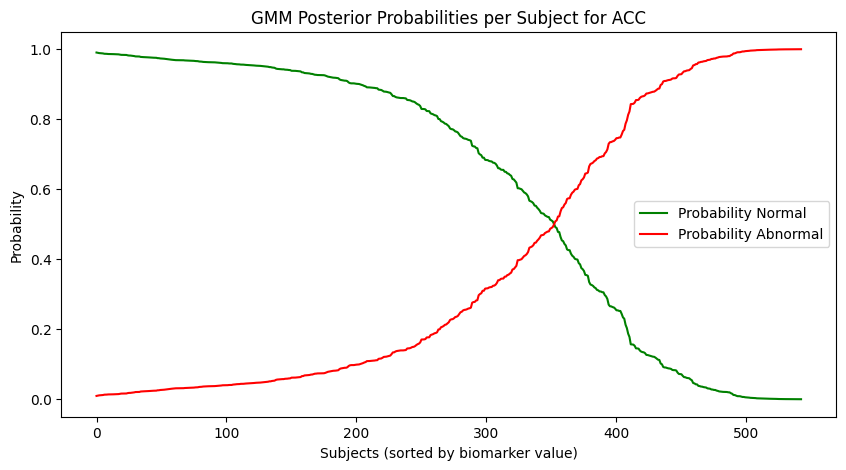

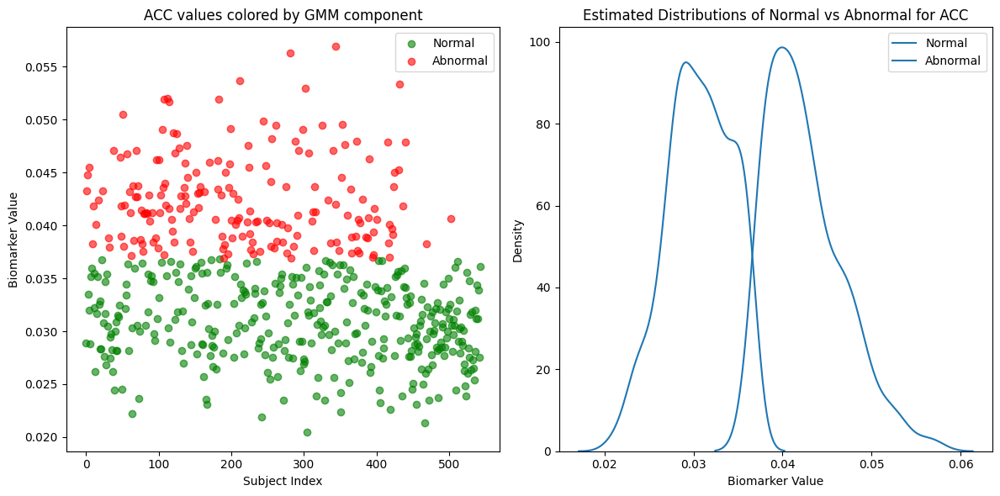

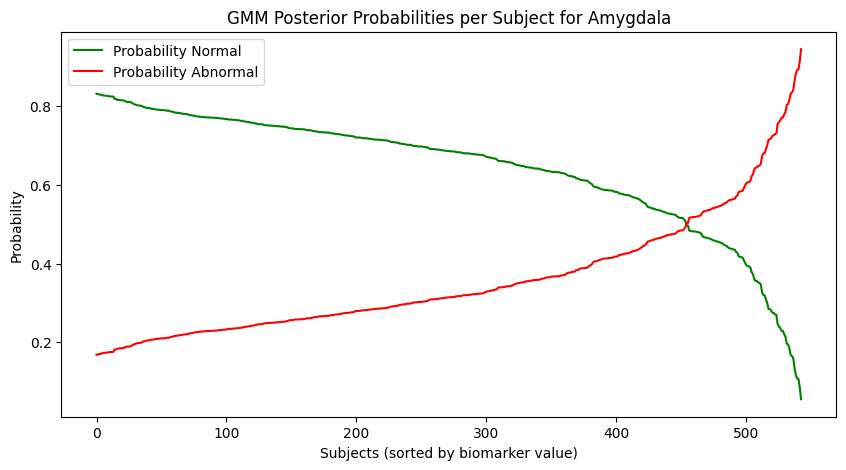

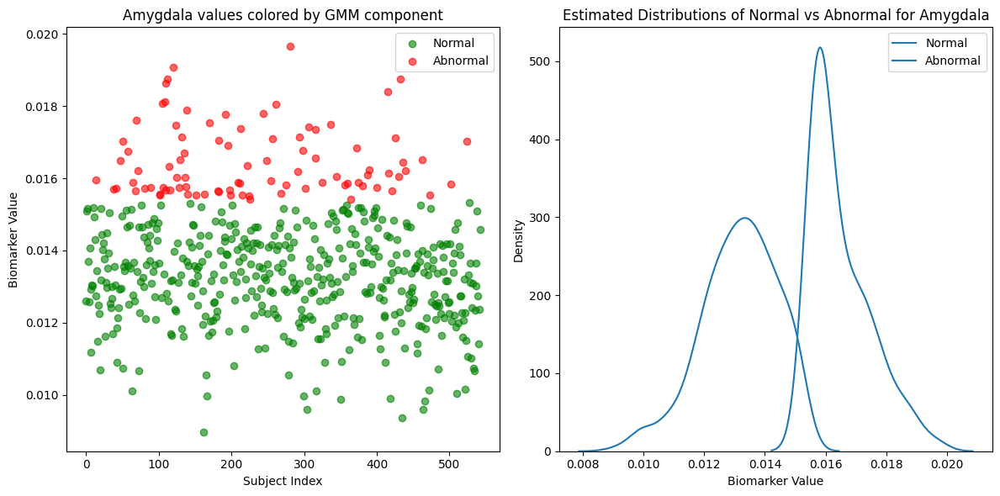

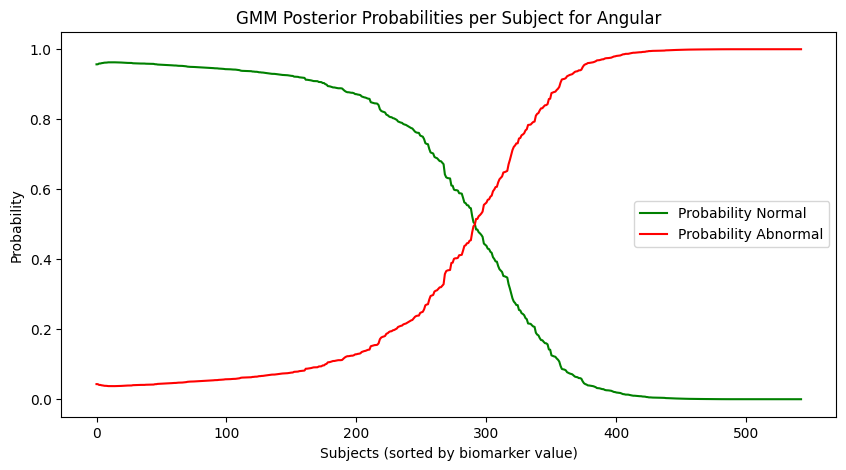

...

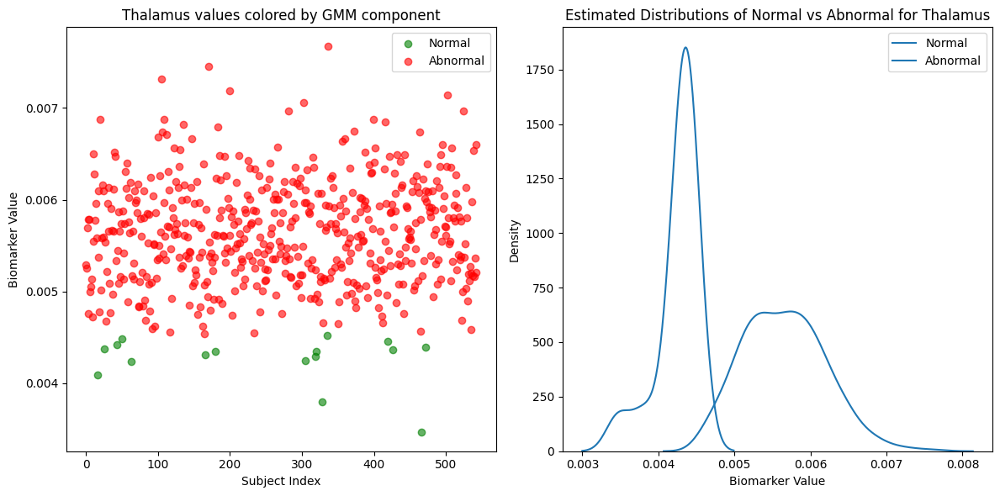

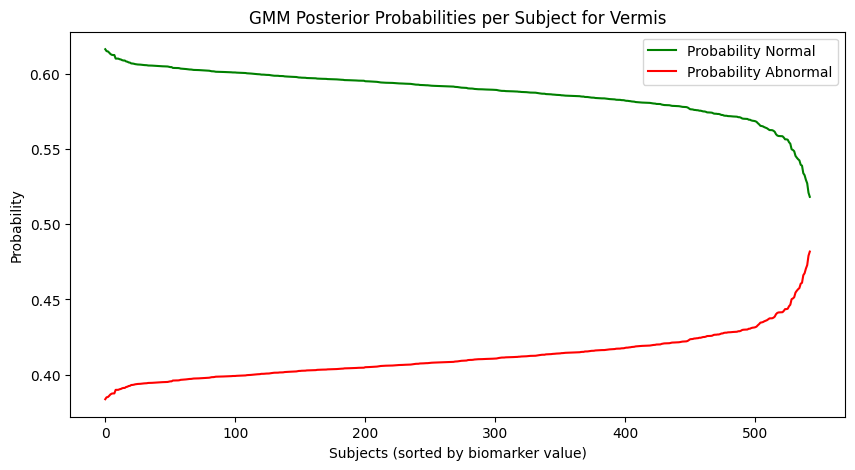

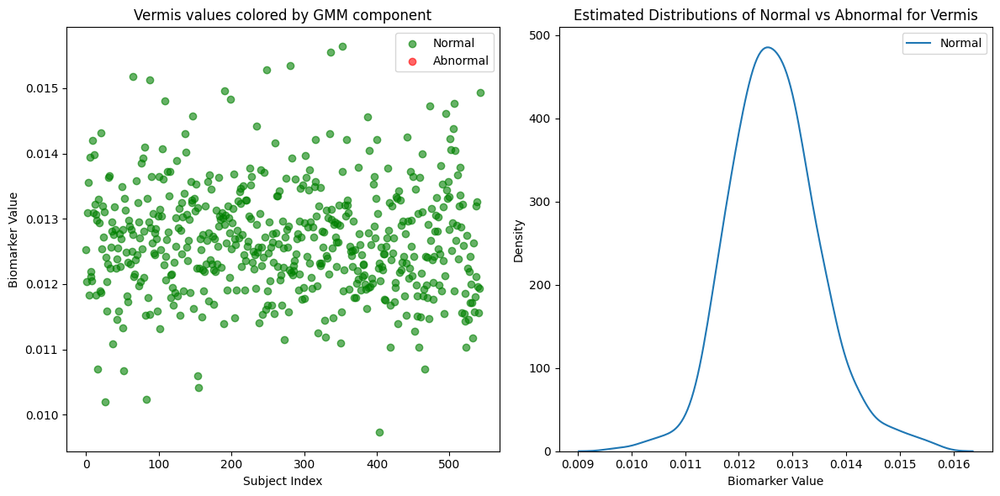

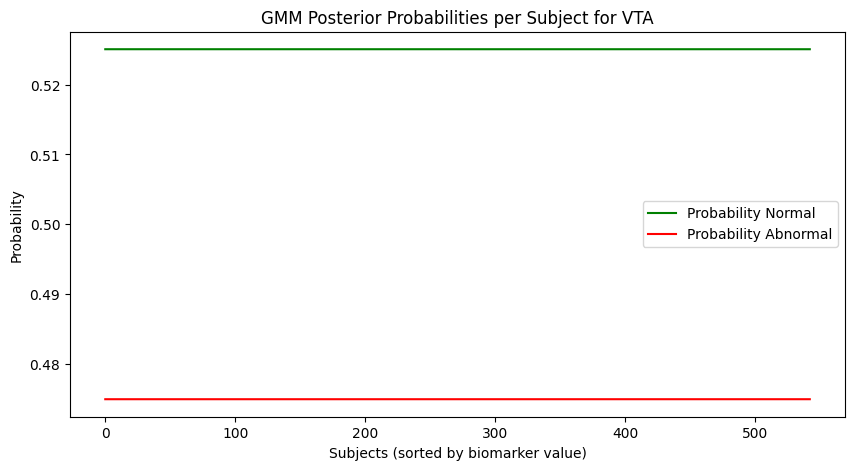

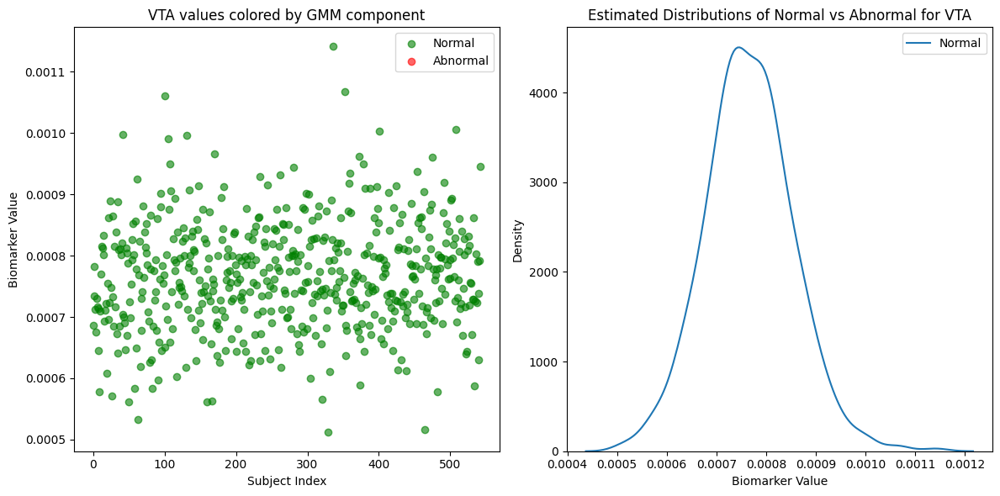

In [13]:
for biomarker in X.columns: # loop through each biomarker and repeat from the test run
    values = X[biomarker].values.reshape(-1, 1)

    gmm = GaussianMixture(n_components=2, covariance_type='full', random_state=0)
    gmm.fit(values)

    probs = gmm.predict_proba(values)

    means = gmm.means_.flatten()
    abnormal_idx = np.argmax(means) 
    normal_idx = np.argmin(means)

    l_no = probs[:, normal_idx]
    l_yes = probs[:, abnormal_idx]


    
    sorted_indices = np.argsort(values.flatten())
    sorted_prob_normal = l_no[sorted_indices]
    sorted_prob_abnormal = l_yes[sorted_indices]

    plt.figure(figsize=(10,5))
    plt.plot(sorted_prob_normal, label='Probability Normal', color='green')
    plt.plot(sorted_prob_abnormal, label='Probability Abnormal', color='red')
    plt.xlabel('Subjects (sorted by biomarker value)')
    plt.ylabel('Probability')
    plt.title('GMM Posterior Probabilities per Subject for ' + biomarker)
    plt.legend()
    plt.show()
    component_labels = np.argmax(probs, axis=1)

    normal_mask = (component_labels == normal_idx)
    abnormal_mask = (component_labels == abnormal_idx)

    plt.figure(figsize=(12,6))

    plt.subplot(1,2,1)
    plt.scatter(np.where(normal_mask), values[normal_mask], color='green', alpha=0.6, label='Normal')
    plt.scatter(np.where(abnormal_mask), values[abnormal_mask], color='red', alpha=0.6, label='Abnormal')
    plt.xlabel('Subject Index')

    plt.ylabel('Biomarker Value')
    plt.title(f'{biomarker} values colored by GMM component')
    plt.legend()

    plt.subplot(1,2,2)
    sns.kdeplot(values[normal_mask], color='green', label='Normal')
    sns.kdeplot(values[abnormal_mask], color='red', label='Abnormal')
    plt.xlabel('Biomarker Value')
    plt.ylabel('Density')
    plt.title(f'Estimated Distributions of Normal vs Abnormal for {biomarker}')
    plt.legend()

    plt.tight_layout()
    plt.show()

we identify the following regions to be unsuitable to be used in this model:
VTA, Vermis, Substantia_Nigra, Red_Nucleus, Raphe, LC

In [14]:
X.drop(columns=['VTA', 'Vermis', 'Substantia_Nigra', 'Red_Nucleus', 'Raphe', 'LC'], inplace=True)

In [15]:
x = list(X.columns)
x

['ACC',
 'Amygdala',
 'Angular',
 'Calcarine',
 'Caudate',
 'Cingulate',
 'Cuneus',
 'Frontal',
 'Fusiform',
 'Heschl',
 'Hippocampus',
 'Insula',
 'Lingual',
 'Nucleus_Accumbens',
 'Occipital',
 'OFC',
 'Olfactory',
 'Pallidum',
 'Paracentral_Lobule',
 'Parahippocampal',
 'Parietal',
 'Postcentral',
 'Precentral',
 'Precuneus',
 'Putamen',
 'Rectus',
 'Rolandic_Oper',
 'Supplementary_Motor_Area',
 'Supramarginal',
 'Temporal',
 'Thalamus']

In [16]:

SuStaInLabels = x 
alphabetical_labels = sorted(SuStaInLabels) # sort alphebetically so that the plot is ordered

biomarker_order = [SuStaInLabels.index(label) for label in alphabetical_labels] # the plotting takes in an indexed list, from the original biomarker labels

In [49]:
X = X[SuStaInLabels] # for mrmr feature

L_yes = pd.DataFrame(index=X.index, columns=X.columns) # dataframe to store the probabilities of each subject belonging to the abnormal component
L_no = pd.DataFrame(index=X.index, columns=X.columns)  # dataframe to store the probabilities of each subject belonging to the normal component

gmm_means = {}

for biomarker in X.columns:
    values = X[biomarker].values.reshape(-1, 1)

    gmm = GaussianMixture(n_components=2, covariance_type='full', random_state=0)
    gmm.fit(values)

    probs = gmm.predict_proba(values)
    
    # Create a value grid across the range
    x_vals = np.linspace(values.min(), values.max(), 1000).reshape(-1, 1)
    x_probs = gmm.predict_proba(x_vals)

    # Find where the absolute difference between component probabilities is minimized
    diff = np.abs(x_probs[:, normal_idx] - x_probs[:, abnormal_idx])
    threshold = x_vals[np.argmin(diff)][0]

    means = gmm.means_.flatten()
    abnormal_idx = np.argmax(means) 
    normal_idx = np.argmin(means)

    l_no = probs[:, normal_idx]
    l_yes = probs[:, abnormal_idx]

    L_no[biomarker] = probs[:, normal_idx] # pobabliites of each subject for each biomarker belonging to the normal component
    L_yes[biomarker] = probs[:, abnormal_idx] # pobabliites of each subject for each biomarker belonging to the abnormal component
    
    gmm_means[biomarker] = {
        'normal_mean': means[normal_idx],
        'abnormal_mean': means[abnormal_idx],
        'threshold': threshold
    }
L_no # check

,ACC,Amygdala,Angular,Calcarine,Caudate,Cingulate,Cuneus,Frontal,Fusiform,Heschl,...,Postcentral,Precentral,Precuneus,Putamen,Rectus,Rolandic_Oper,Supplementary_Motor_Area,Supramarginal,Temporal,Thalamus
0,0.954569,0.748804,9.608996e-01,0.967498,0.623881,0.940505,0.952161,0.969092,0.956787,0.872921,...,0.963041,0.949302,0.964875,0.946811,0.958614,0.970271,0.924142,9.663859e-01,0.996201,0.497504
1,0.026430,0.536415,4.022229e-09,0.003627,0.413140,0.026358,0.010592,0.000235,0.003129,0.593640,...,0.000465,0.002359,0.000002,0.366193,0.009575,0.002480,0.015862,8.928041e-07,0.000101,0.497604
2,0.010301,0.526962,4.002360e-05,0.014494,0.637723,0.401978,0.076563,0.013199,0.000068,0.487691,...,0.102517,0.222680,0.000882,0.289038,0.005799,0.029318,0.146231,6.721864e-03,0.000202,0.496121
3,0.810769,0.676208,8.715450e-01,0.927752,0.436115,0.912319,0.919553,0.841930,0.845740,0.835185,...,0.868216,0.876111,0.920003,0.890130,0.907233,0.834440,0.831332,8.116111e-01,0.972314,0.495812
4,0.884132,0.750613,8.485801e-01,0.958210,0.737870,0.886049,0.948307,0.949611,0.881238,0.868515,...,0.963083,0.956460,0.806762,0.959363,0.849478,0.967840,0.894001,9.485309e-01,0.965033,0.499245
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
538,0.751565,0.535776,9.570925e-01,0.911698,0.300016,0.912951,0.828453,0.987170,0.700530,0.828619,...,0.959147,0.936152,0.918694,0.428396,0.791540,0.898270,0.908473,9.670884e-01,0.988503,0.493244
539,0.910115,0.741241,2.111966e-01,0.943423,0.269253,0.758197,0.862649,0.005539,0.968951,0.854546,...,0.002696,0.006951,0.911578,0.936331,0.911525,0.471154,0.179825,6.860039e-03,0.811804,0.497906
540,0.786513,0.797800,6.922481e-01,0.869336,0.568155,0.645221,0.839028,0.303030,0.968845,0.797958,...,0.094289,0.464682,0.872981,0.930138,0.753333,0.698473,0.555585,4.031719e-01,0.941390,0.497241
541,0.968631,0.760778,9.301409e-01,0.923105,0.706573,0.909483,0.935123,0.965191,0.959837,0.852072,...,0.878695,0.867982,0.942346,0.960746,0.971036,0.948797,0.900197,7.575446e-01,0.980661,0.497753


In [18]:
L_yes = L_yes.to_numpy()
L_no = L_no.to_numpy()
N = len(X.columns)
N

31

In [19]:
len(SuStaInLabels)

31

In [20]:

N_startpoints = 10
N_S_max = 3
N_iterations_MCMC = int(1e4)
output_folder = os.path.join(os.getcwd(), 'Mixture') # we change this for each of the different tests
dataset_name = '31_larger_regions'

# Initiate the SuStaIn object
sustain_input = MixtureSustain(
                              L_yes, # here
                              L_no, # and here
                              SuStaInLabels,
                              N_startpoints,
                              N_S_max, 
                              N_iterations_MCMC, 
                              output_folder, 
                              dataset_name, 
                              True) # this is for running in parallel, set to false if you want to run single core

In [21]:
if not os.path.isdir(output_folder): # create dir
    os.mkdir(output_folder)

In [22]:
samples_sequence,   \
samples_f,          \
ml_subtype,         \
prob_ml_subtype,    \
ml_stage,           \
prob_ml_stage,      \
prob_subtype_stage  = sustain_input.run_sustain_algorithm()

Found pickle file: c:\Users\huw\OneDrive\Documents\Research_Internship\adni-ml\Mixture\pickle_files\31_larger_regions_subtype0.pickle. Using pickled variables for 0 subtype.
Found pickle file: c:\Users\huw\OneDrive\Documents\Research_Internship\adni-ml\Mixture\pickle_files\31_larger_regions_subtype1.pickle. Using pickled variables for 1 subtype.
Found pickle file: c:\Users\huw\OneDrive\Documents\Research_Internship\adni-ml\Mixture\pickle_files\31_larger_regions_subtype2.pickle. Using pickled variables for 2 subtype.


Loading pickle file: c:\Users\huw\OneDrive\Documents\Research_Internship\adni-ml\Mixture/pickle_files/31_larger_regions_subtype2.pickle


c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\pySuStaIn\MixtureSustain.py:350: UserWarning: Both labels and an order have been given. The labels will be reordered according to the given order!
  warnings.warn(


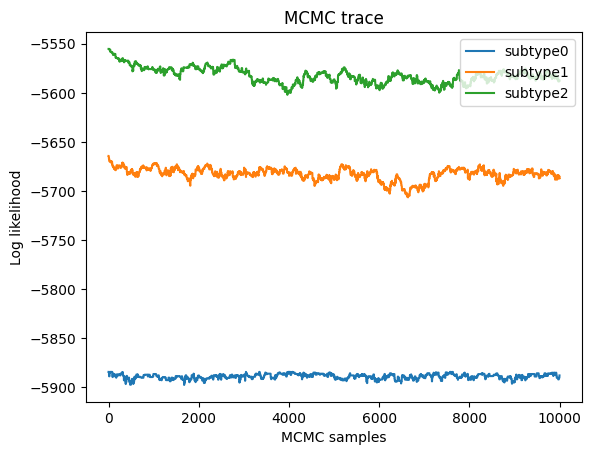

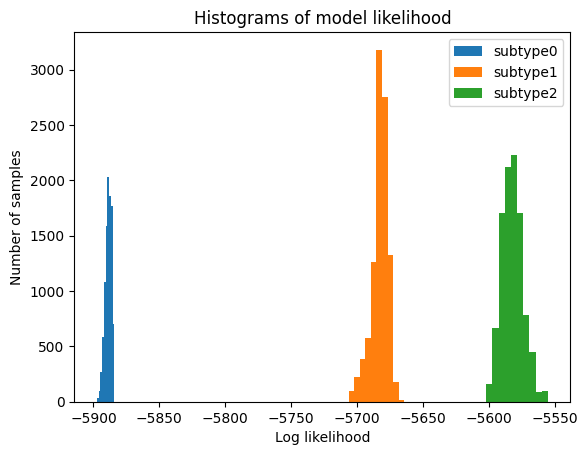

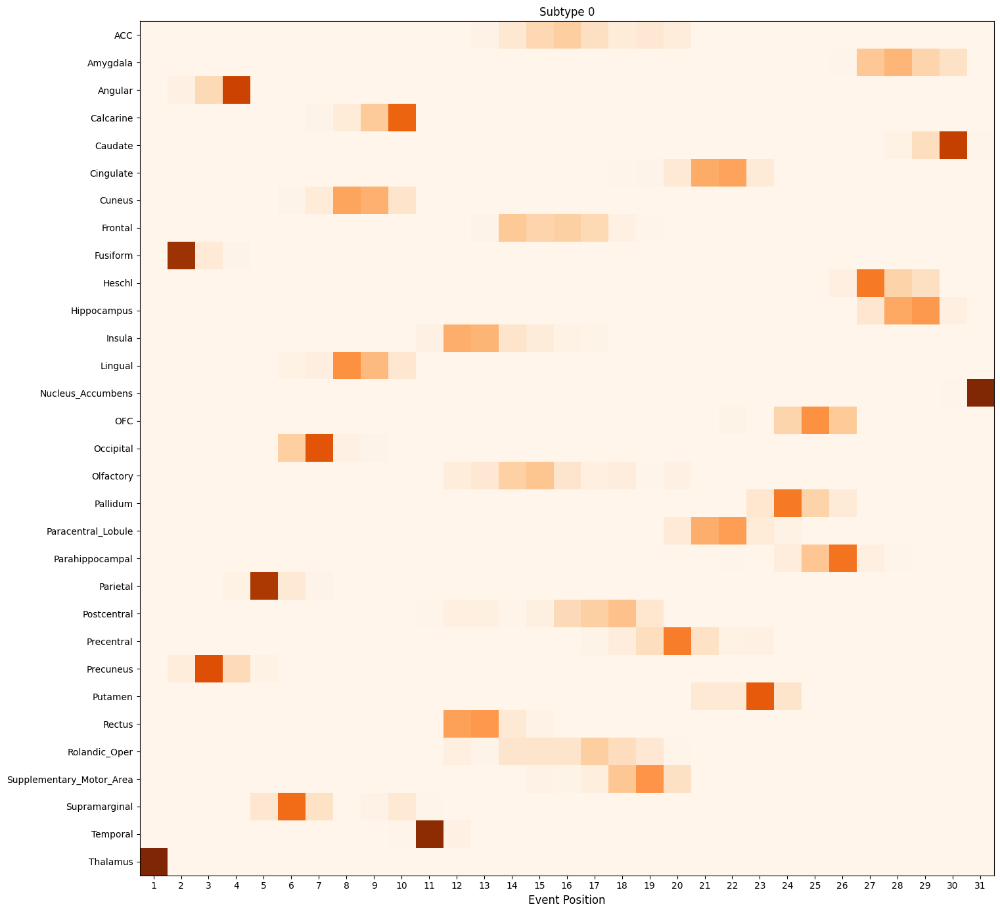

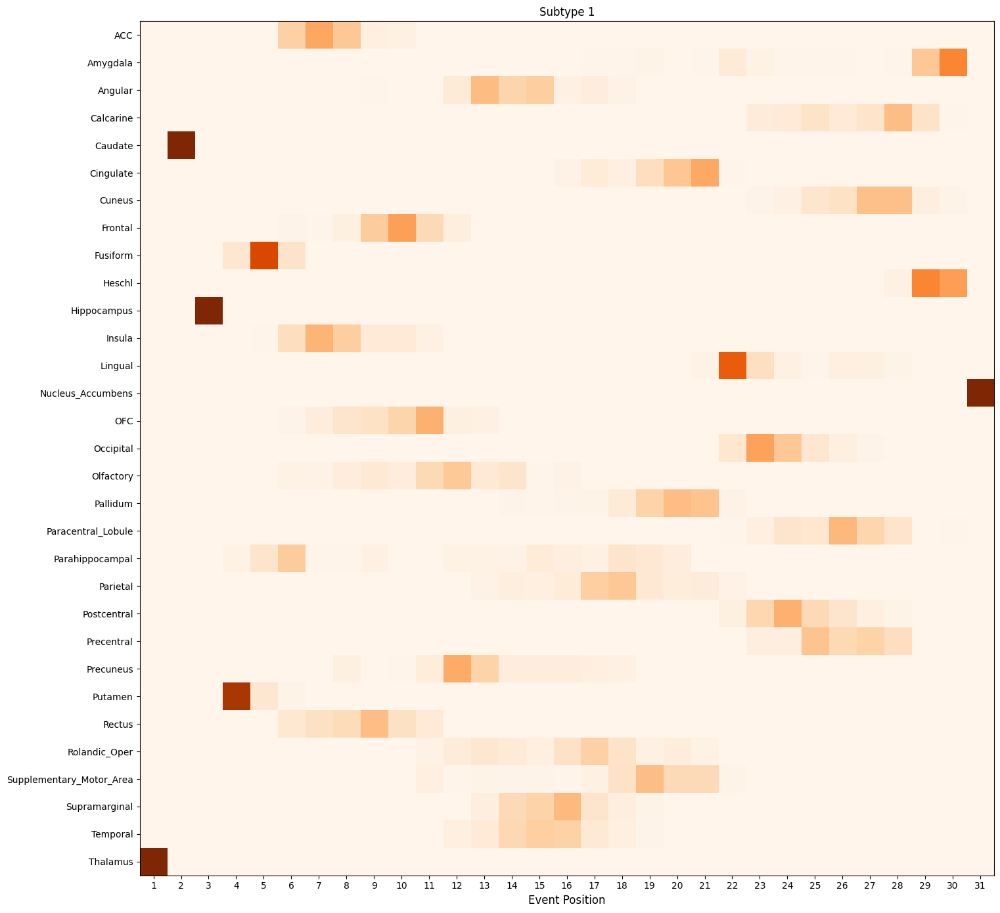

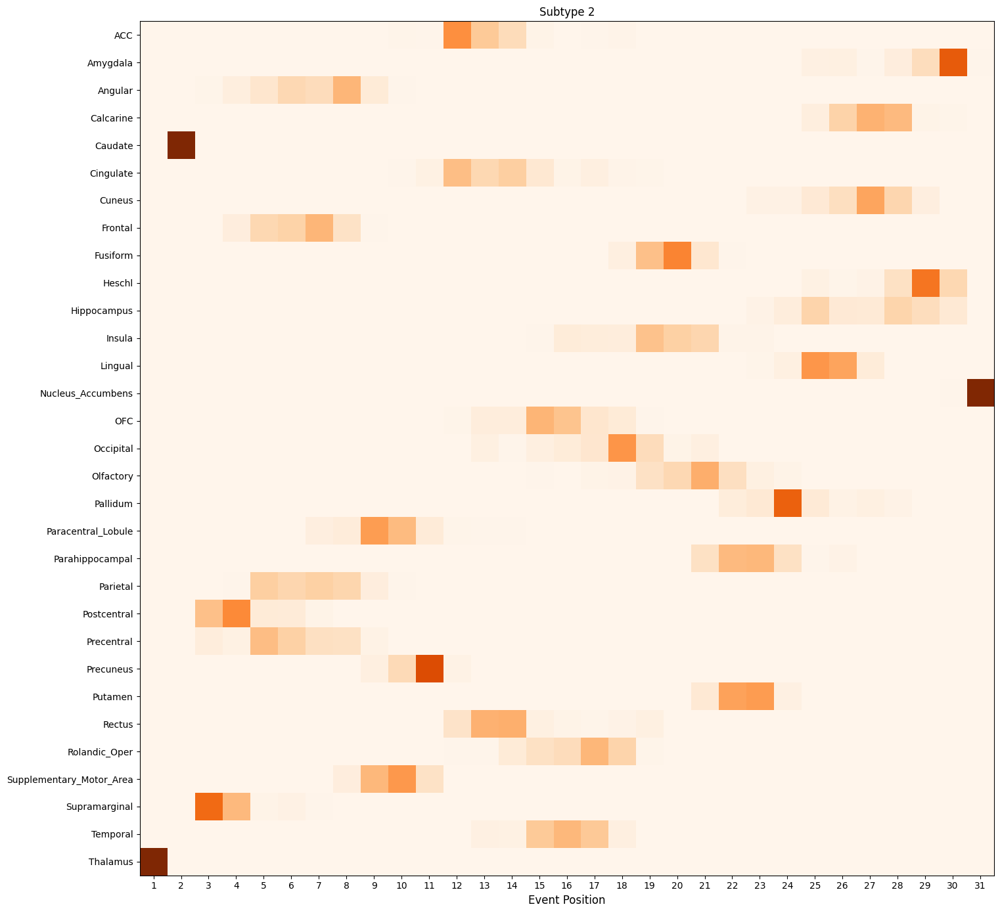

In [23]:
for s in range(N_S_max):
    # load pickle file (SuStaIn output) and get the sample log likelihood values
    pickle_filename_s = output_folder + '/pickle_files/' + dataset_name + '_subtype' + str(s) + '.pickle'
    pk = pd.read_pickle(pickle_filename_s)
    samples_likelihood = pk["samples_likelihood"]
    
    # plot the values as a line plot
    plt.figure(0)
    plt.plot(range(N_iterations_MCMC), samples_likelihood, label="subtype" + str(s))
    plt.legend(loc='upper right')
    plt.xlabel('MCMC samples')
    plt.ylabel('Log likelihood')
    plt.title('MCMC trace')
    
    # plot the values as a histogramp plot
    plt.figure(1)
    plt.hist(samples_likelihood, label="subtype" + str(s))
    plt.legend(loc='upper right')
    plt.xlabel('Log likelihood')  
    plt.ylabel('Number of samples')  
    plt.title('Histograms of model likelihood')
    
s = 2 # 1 split = 2 subtypes

M = len(df) 

# get the sample sequences and f
pickle_filename_s = output_folder + '/pickle_files/' + dataset_name + '_subtype' + str(s) + '.pickle'
print("Loading pickle file:", pickle_filename_s)
pk = pd.read_pickle(pickle_filename_s)
samples_sequence = pk["samples_sequence"]
samples_f = pk["samples_f"]

# use this information to plot the positional variance diagrams, note the biomarker order and labels
tmp=MixtureSustain._plot_sustain_model(sustain_input,samples_sequence,samples_f,M, figsize = (24,14), biomarker_order = biomarker_order, biomarker_labels = SuStaInLabels, subtype_titles=['Subtype 0', 'Subtype 1', 'Subtype 2'], separate_subtypes=True)



In [24]:
zdata = df.copy()
s = 2
pickle_filename_s = output_folder + '/pickle_files/' + dataset_name + '_subtype' + str(s) + '.pickle'
print("Loading pickle file:", pickle_filename_s)
pk = pd.read_pickle(pickle_filename_s)

for variable in ['ml_subtype', # the assigned subtype
                 'prob_ml_subtype', # the probability of the assigned subtype
                 'ml_stage', # the assigned stage 
                 'prob_ml_stage',]: # the probability of the assigned stage
    
    
    # add SuStaIn output to dataframe
    zdata.loc[:,variable] = pk[variable] 

# let's also add the probability for each subject of being each subtype
for i in range(s):
    zdata.loc[:,'prob_S%s'%i] = pk['prob_subtype'][:,i]
zdata.head()

zdata.ml_subtype.value_counts()



zdata = zdata.merge(regions_df, on='PTID')

Loading pickle file: c:\Users\huw\OneDrive\Documents\Research_Internship\adni-ml\Mixture/pickle_files/31_larger_regions_subtype2.pickle


# Brain order images

Originally the method uses the name of the features being the same as the masks name. This no longer holds. We need to loop through all th eregions in each group and plot them.

In [25]:
# we need the a list of the 'most likely' order of biomarkers for each subtype. Alot of this is taken from the source code for the positional variance plots above, so we have the same input into this function as the plotting fn
def get_biomarker_order_by_stage(
        samples_sequence, 
        samples_f, 
        n_samples, 
        biomarker_labels=None, 
        ml_f_EM=None, 
        cval=False, 
        subtype_order=None, 
        biomarker_order=None):
 
    
    # get number of subtypes and biomarkers
    N_S = samples_sequence.shape[0]
    N_bio = samples_sequence.shape[1]

    # Set subtype order if not provided
    if subtype_order is None:
        if ml_f_EM is not None:
            subtype_order = np.argsort(ml_f_EM)[::-1]
        else:
            subtype_order = np.argsort(np.mean(samples_f, 1))[::-1]

    # Use default biomarker order if none given
    if biomarker_order is None:
        biomarker_order = np.arange(N_bio)

    # Handle biomarker labels if provided
    if biomarker_labels is None:
        biomarker_labels = [f"Biomarker {i}" for i in range(N_bio)]
    else:
        biomarker_labels = [biomarker_labels[i] for i in biomarker_order]

    # Store ordered lists per subtype
    subtype_biomarker_orders = {}

    for i in range(N_S):
        # Grab samples for this subtype (transpose to (N_bio, N_samples))
        this_samples_sequence = samples_sequence[subtype_order[i], :, :].T
        N = this_samples_sequence.shape[1]

        # Construct confusion matrix: biomarker vs stage
        confus_matrix = (this_samples_sequence == np.arange(N)[:, None, None]).sum(1) / this_samples_sequence.shape[0]

        # Find most likely stage for each biomarker
        biomarker_stage_order = np.argmax(confus_matrix, axis=1)

        # Sort biomarkers by stage
        order_by_stage = np.argsort(biomarker_stage_order)

        ordered_labels = [biomarker_labels[j] for j in order_by_stage]

        # Store result (Subtype i+1 so it matches plotting convention)
        subtype_biomarker_orders[f"Subtype {i}"] = ordered_labels

    return subtype_biomarker_orders


ordered_biomarkers = get_biomarker_order_by_stage(samples_sequence, samples_f, n_samples=M, biomarker_labels=SuStaInLabels, biomarker_order=None,subtype_order=None)

# we check with the positional vaiance plots that the order is correct, which they are
for subtype, order in ordered_biomarkers.items():
    print(f"{subtype}:")
    print(order)

Subtype 0:
['Thalamus', 'Fusiform', 'Precuneus', 'Angular', 'Parietal', 'Supramarginal', 'Occipital', 'Cuneus', 'Lingual', 'Calcarine', 'Temporal', 'Insula', 'Rectus', 'Frontal', 'Olfactory', 'ACC', 'Rolandic_Oper', 'Postcentral', 'Supplementary_Motor_Area', 'Precentral', 'Paracentral_Lobule', 'Cingulate', 'Putamen', 'Pallidum', 'OFC', 'Parahippocampal', 'Heschl', 'Amygdala', 'Hippocampus', 'Caudate', 'Nucleus_Accumbens']
Subtype 1:
['Thalamus', 'Caudate', 'Hippocampus', 'Putamen', 'Fusiform', 'Parahippocampal', 'Insula', 'ACC', 'Rectus', 'Frontal', 'OFC', 'Precuneus', 'Olfactory', 'Angular', 'Temporal', 'Supramarginal', 'Rolandic_Oper', 'Parietal', 'Supplementary_Motor_Area', 'Pallidum', 'Cingulate', 'Lingual', 'Occipital', 'Postcentral', 'Precentral', 'Paracentral_Lobule', 'Cuneus', 'Calcarine', 'Heschl', 'Amygdala', 'Nucleus_Accumbens']
Subtype 2:
['Thalamus', 'Caudate', 'Supramarginal', 'Postcentral', 'Precentral', 'Parietal', 'Frontal', 'Angular', 'Paracentral_Lobule', 'Supplement

In [ ]:
from nilearn import image, plotting, datasets
import numpy as np
import nibabel as nib

# these functions are used to build ranked and cumulative masks form the biomarker orders

mask_dir = r"C:\Users\huw\OneDrive\Documents\Year_4\Project\new_masks\new_masks" # directory to folder with the aal3 atlas masks
mni = datasets.load_mni152_template() # mni template for background image


def find_mask_paths(region_name, mask_dir, region_groups):
    if region_name not in region_groups:
        raise ValueError(f"Region '{region_name}' not found in region_groups dictionary.")
    
    paths = []
    for filename in region_groups[region_name]:
        path = os.path.join(mask_dir, filename)
        if not os.path.exists(path):
            raise FileNotFoundError(f"Mask file '{filename}' not found in '{mask_dir}'.")
        paths.append(path)
    return paths

# build the rank image. One image overalyed with all the regions that are colour coded depending on their event order
def build_rank_img(order_list, mask_dir, region_groups, target_img=None):
    first_paths = find_mask_paths(order_list[0], mask_dir, region_groups)
    first_img = nib.load(first_paths[0]) if target_img is None else target_img

    rank_data = np.zeros(first_img.shape, dtype=np.int16)
    rank_affine = first_img.affine

    for idx, region in enumerate(order_list, start=1):
        mask_paths = find_mask_paths(region, mask_dir, region_groups)

        for path in mask_paths:
            m = nib.load(path)

            # Resample to target_img grid
            if target_img is not None:
                m = image.resample_to_img(m, target_img, interpolation="nearest", force_resample = True, copy_header=True)
            elif m.shape != first_img.shape or not np.allclose(m.affine, first_img.affine):
                m = image.resample_to_img(m, first_img, interpolation="nearest", force_resample = True, copy_header=True)

            m_data = m.get_fdata()
            on_mask = m_data > 0


            rank_data[on_mask & (rank_data == 0)] = idx

    return nib.Nifti1Image(rank_data, rank_affine)

def cumulative_mask(order_list, mask_dir, region_groups, k, target_img):
    acc = None

    for region in order_list[:k]:
        mask_paths = find_mask_paths(region, mask_dir, region_groups)

        for path in mask_paths:
            m = nib.load(path)
            m = image.resample_to_img(m, target_img, interpolation="nearest", force_resample=True, copy_header=True)
            data = (m.get_fdata() > 0).astype(np.uint8)

            acc = data if acc is None else np.maximum(acc, data)

    return nib.Nifti1Image(acc, target_img.affine)



c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



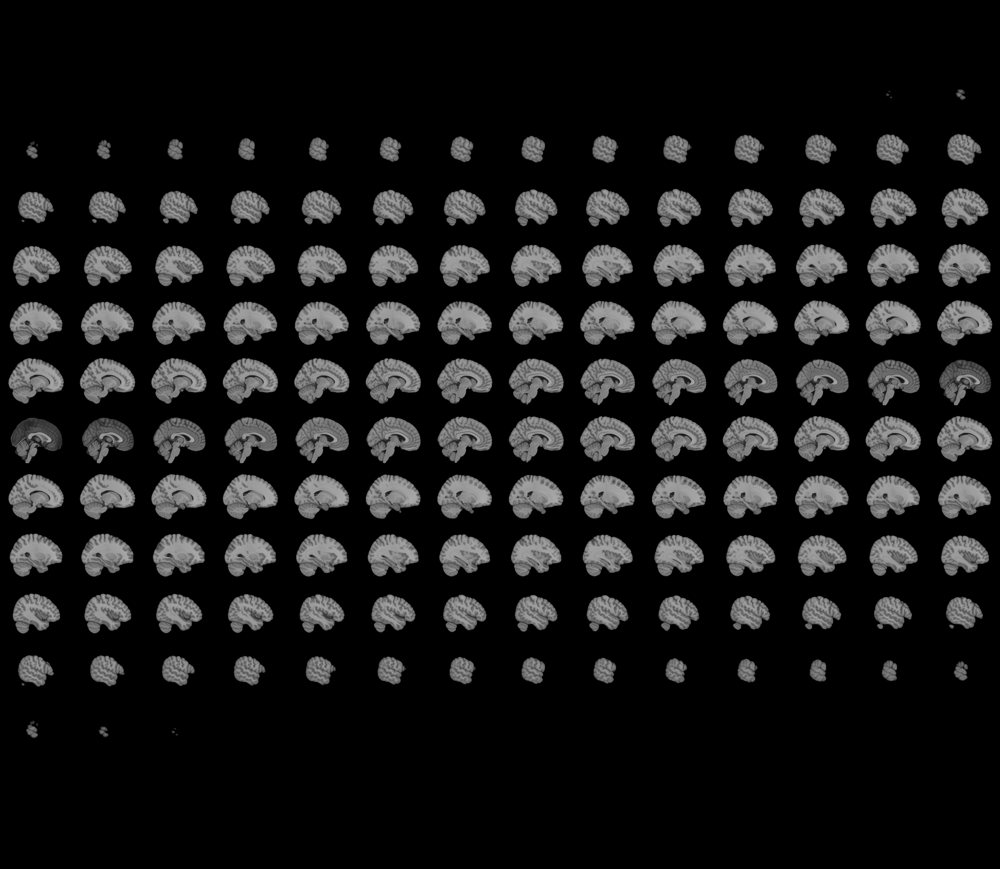
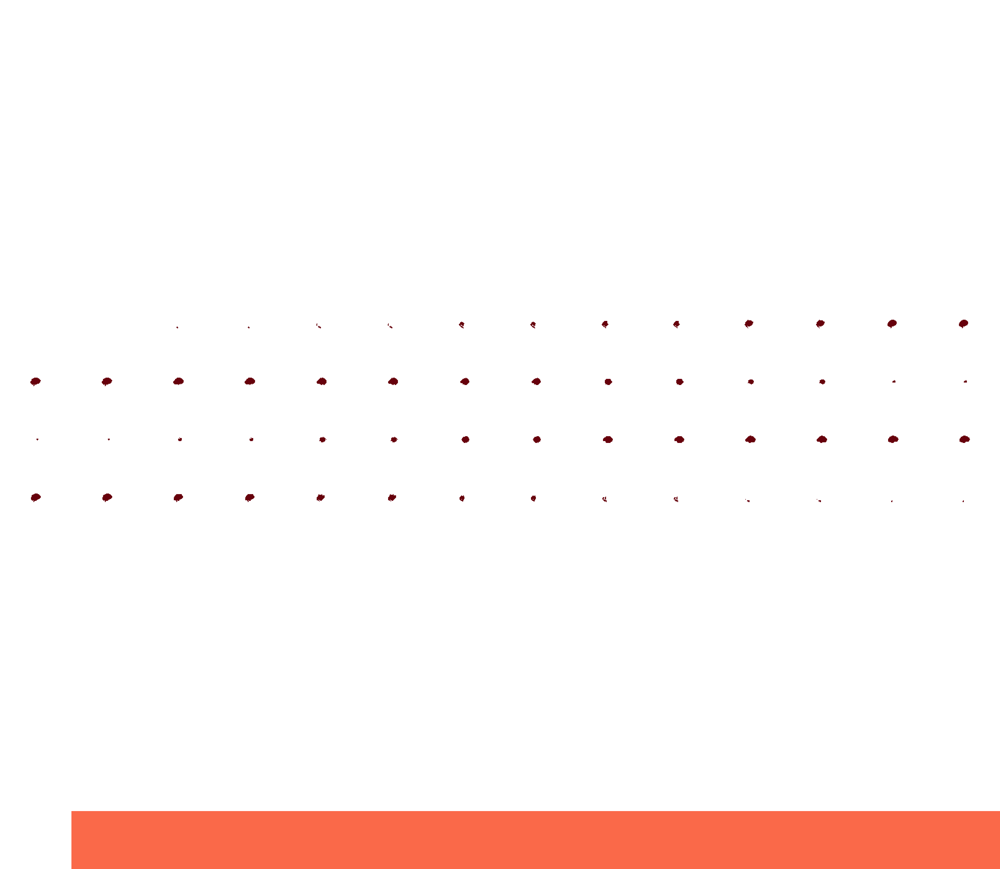

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



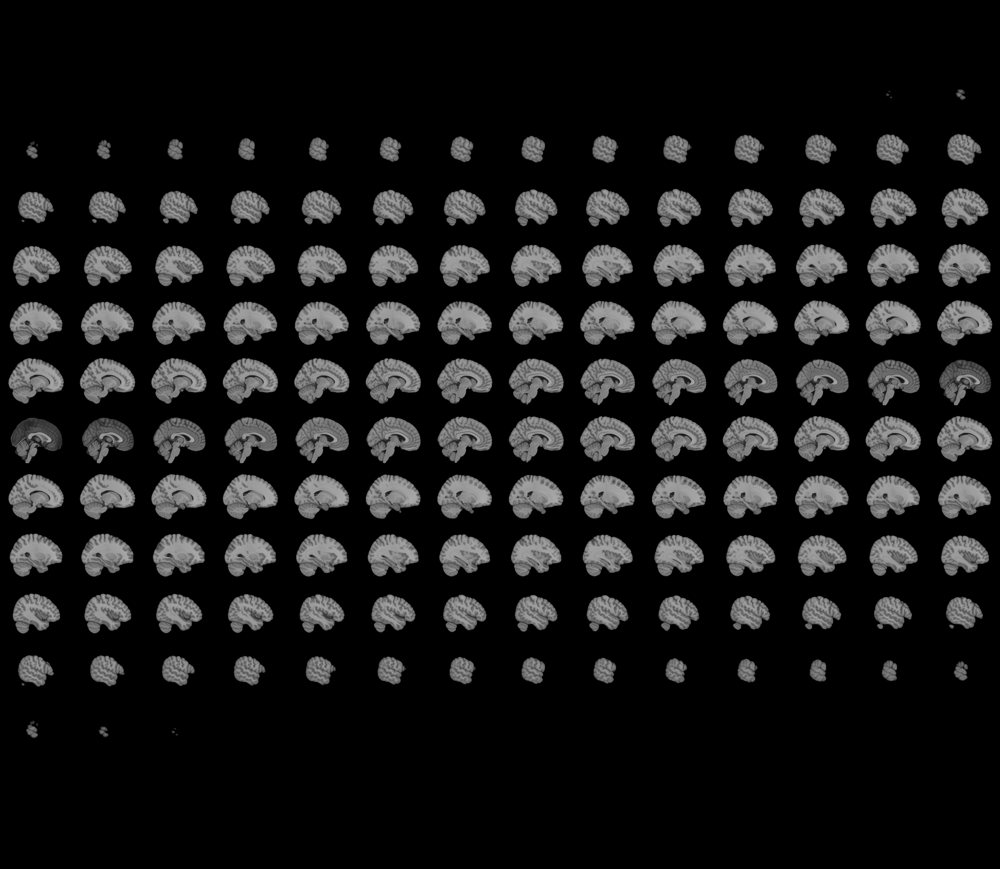
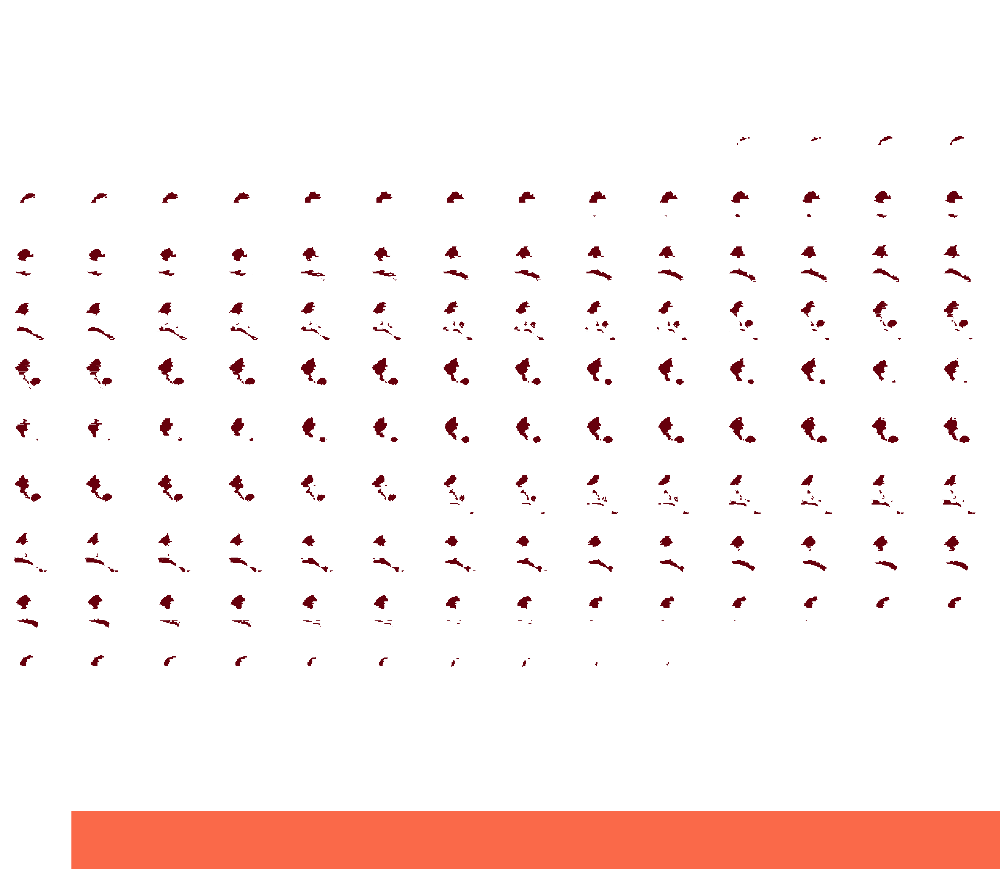

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



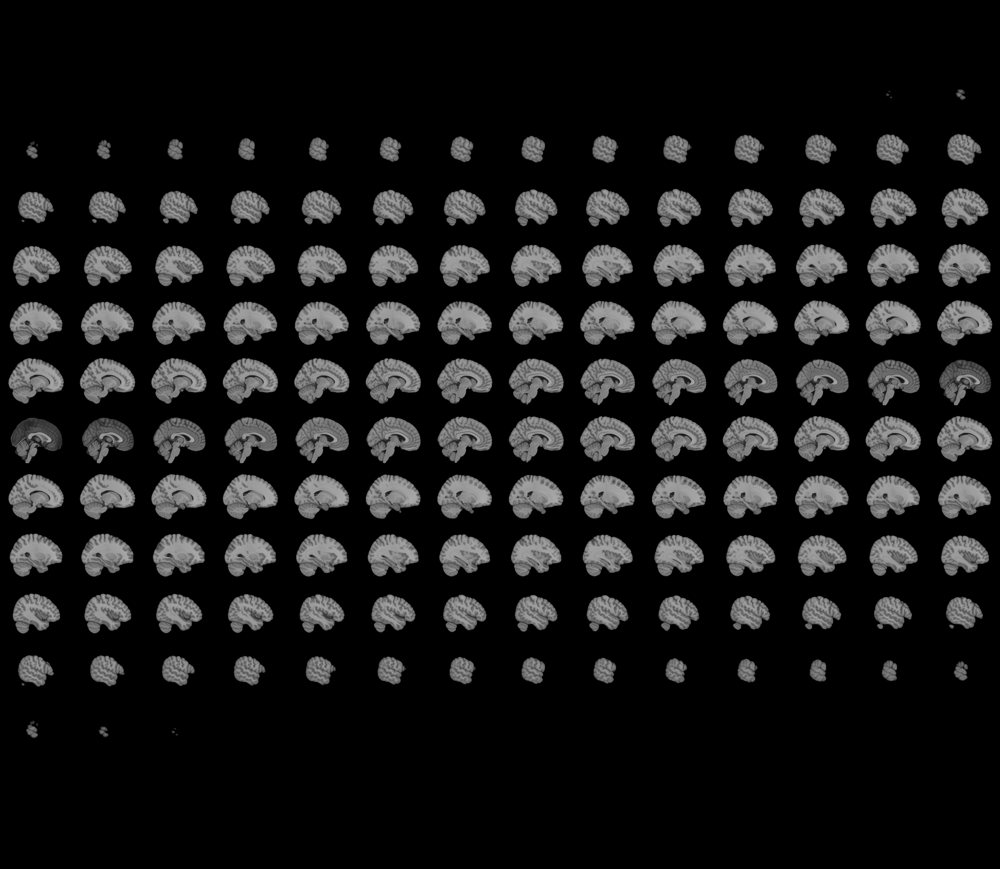
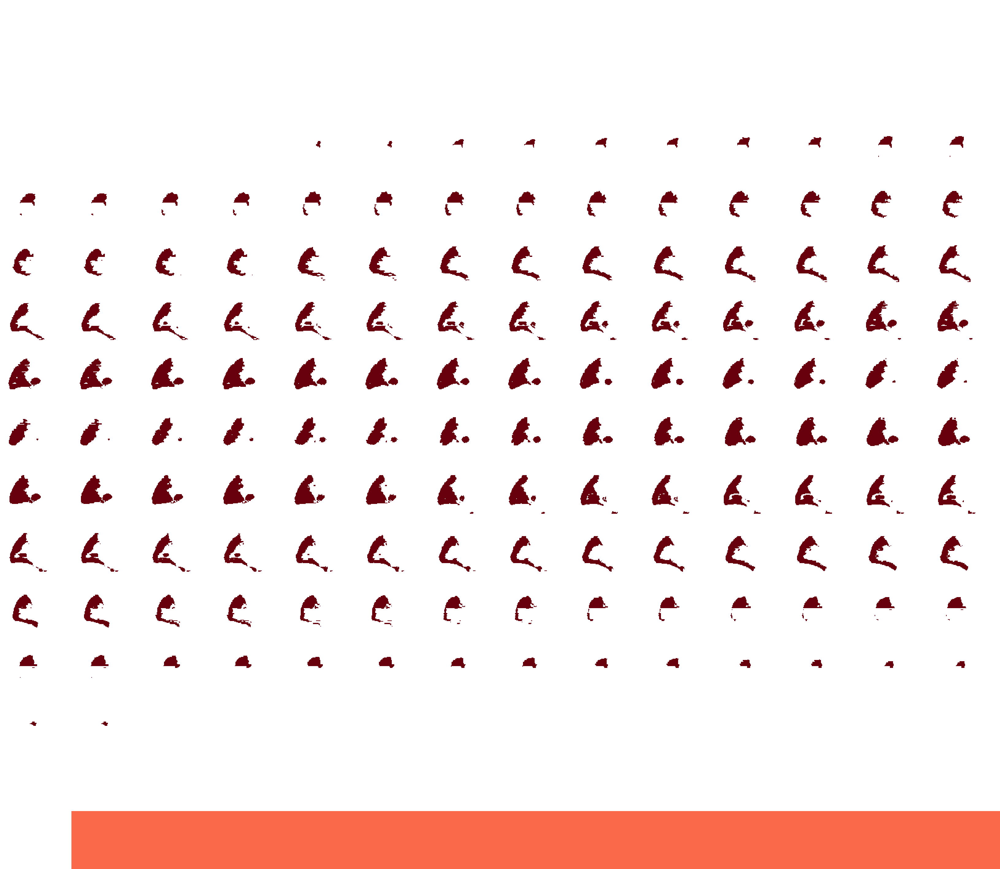

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



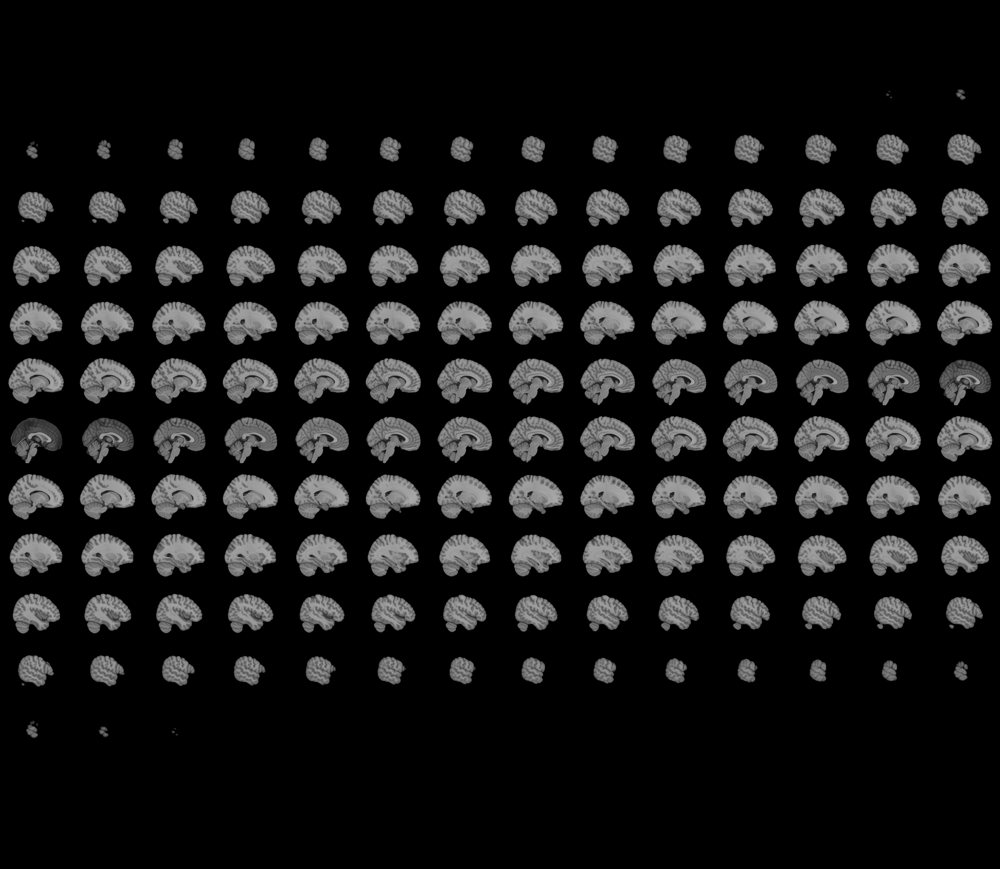
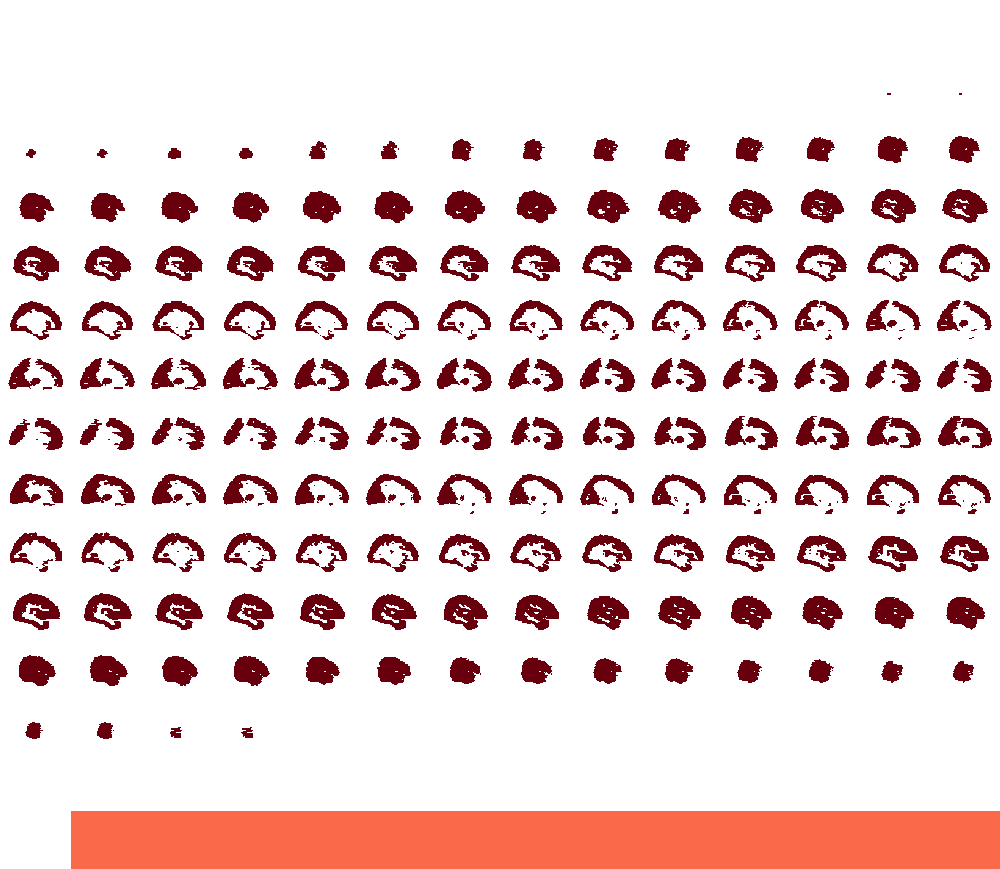

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



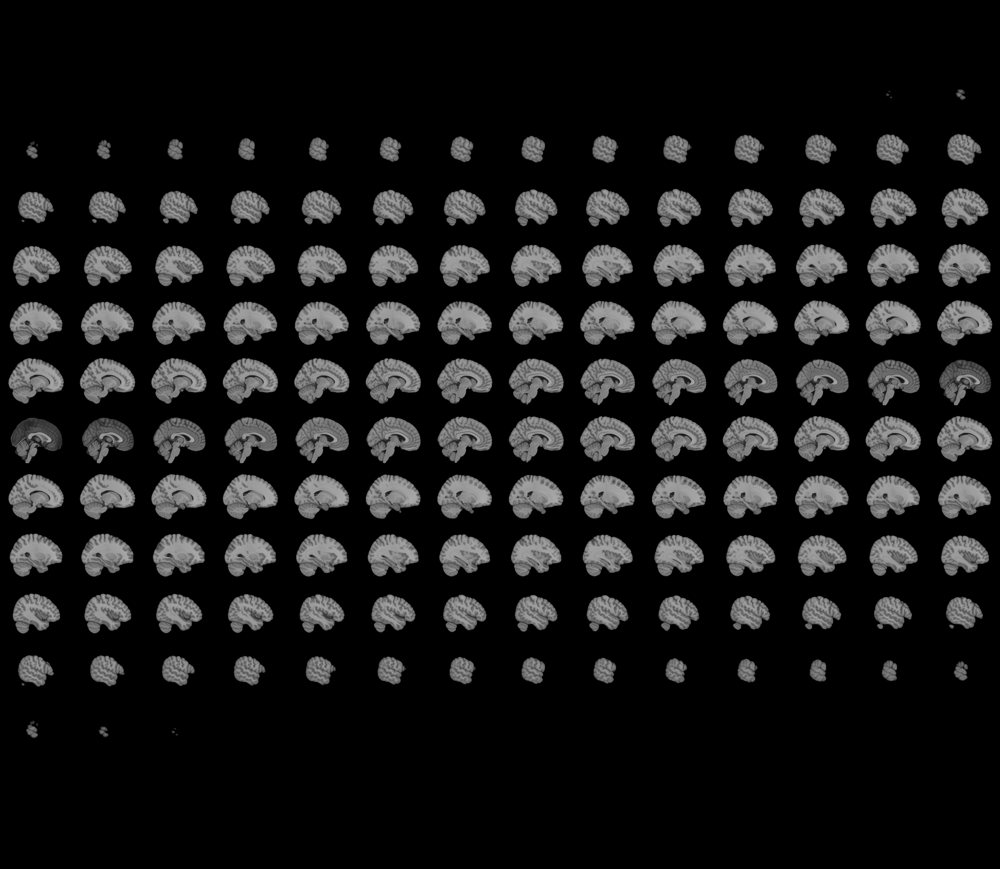
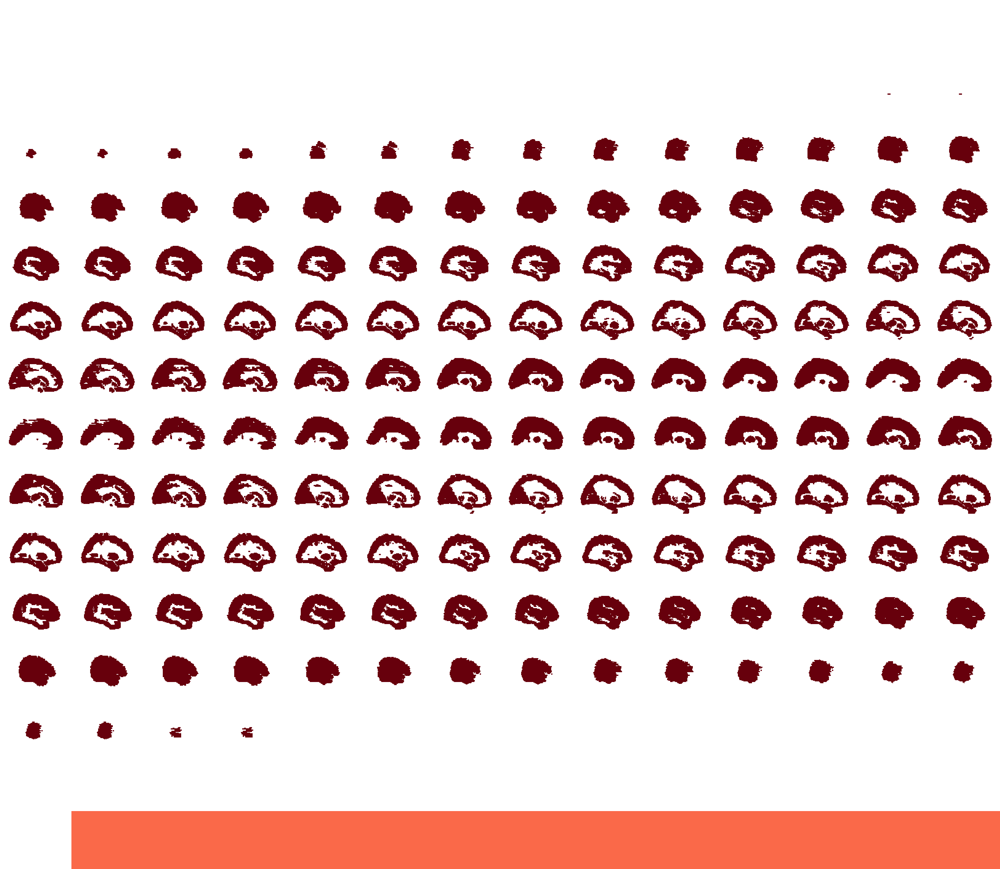

In [27]:
subtype = list(ordered_biomarkers.keys())[0]  # pick one, or loop over all
order_list = ordered_biomarkers[subtype]

order_list = [label.replace('SUVr_', '') for label in order_list ]
order_list

for k in (1, 5, 10, 20, 31):
    cmask = cumulative_mask(order_list, mask_dir, region_groups, k, mni)
    view = plotting.view_img(
        cmask,
        bg_img=mni,
        threshold=0.5,        # show only voxels > 0.5 (binary mask)
        opacity=0.7,          # mask transparency
        cmap='Reds',
        title = f'Regions up to stage {k}',
        colorbar=False,
    )
    display(view)    

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



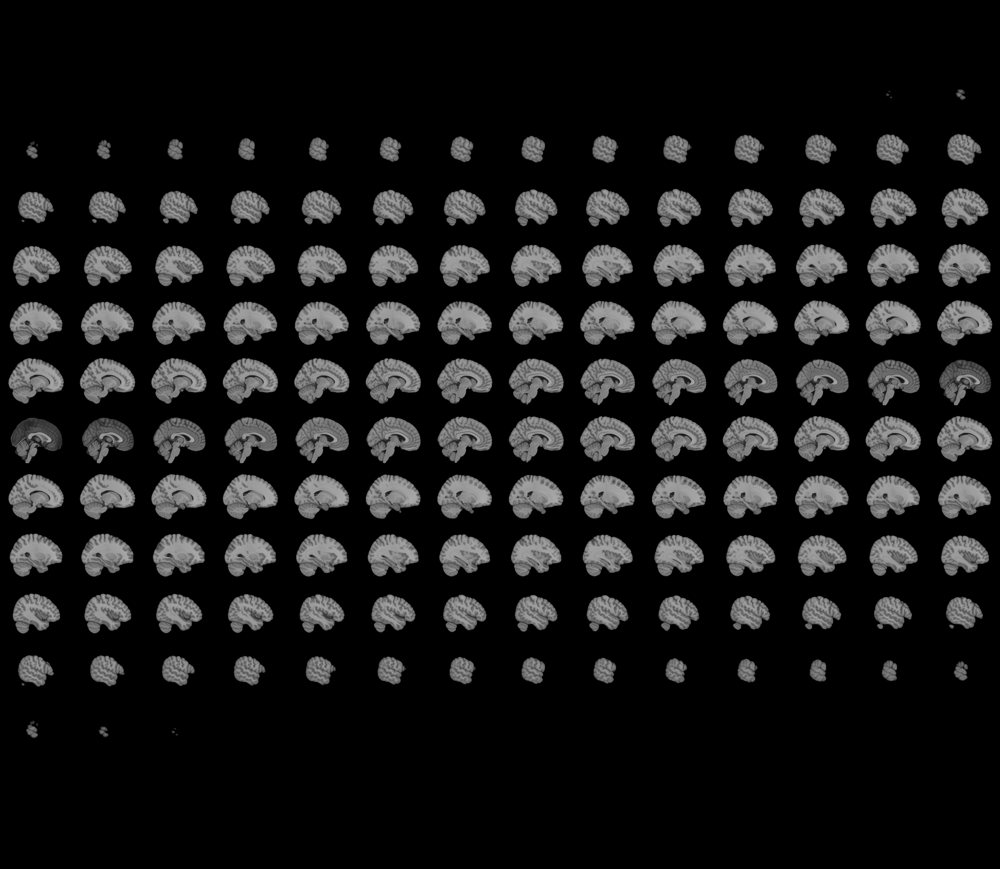
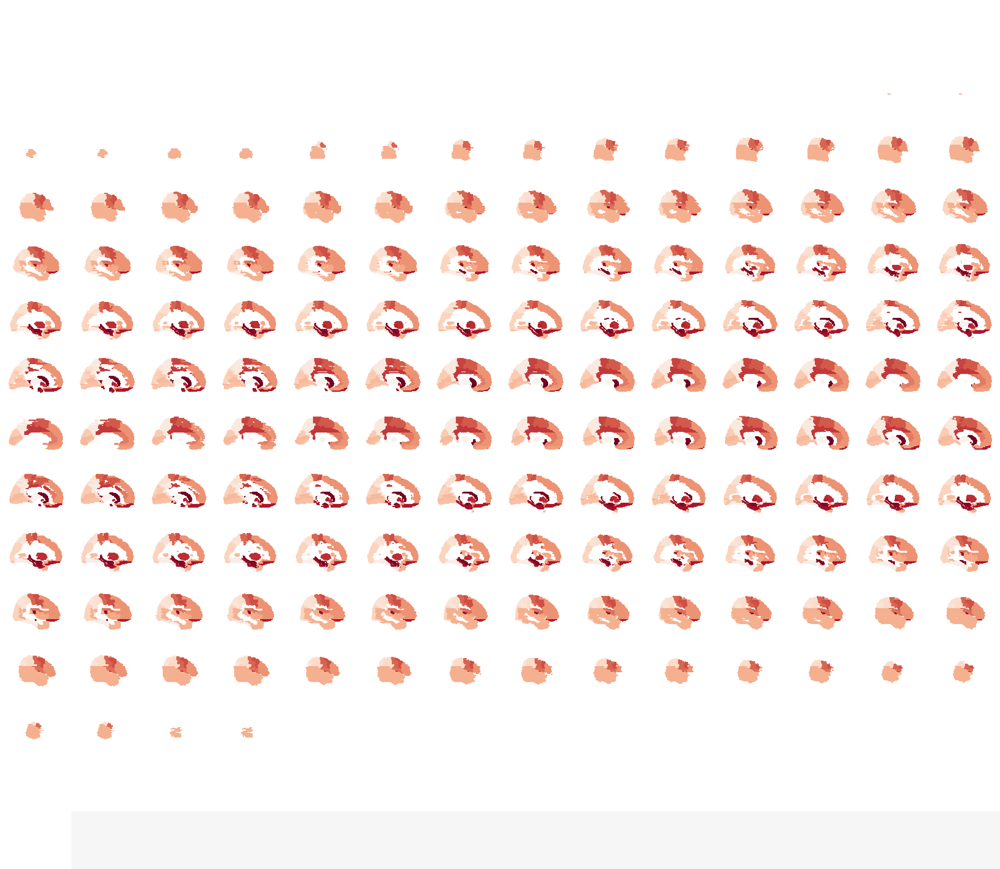

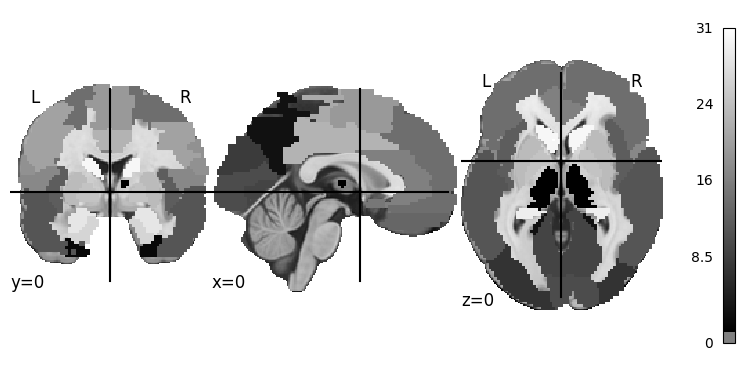

In [28]:
rank_img = build_rank_img(order_list, mask_dir, region_groups, target_img=mni)


# Plot static orthogonal views with a colorbar (shows rank values)
plot = plotting.plot_img(
    rank_img,
    bg_img=mni,
    display_mode="ortho",
    cut_coords=(0, 0, 0),  # adjust to taste
    threshold=0,           # show all positive ranks
    colorbar=True
)

view = plotting.view_img(rank_img, bg_img=mni)
view  

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



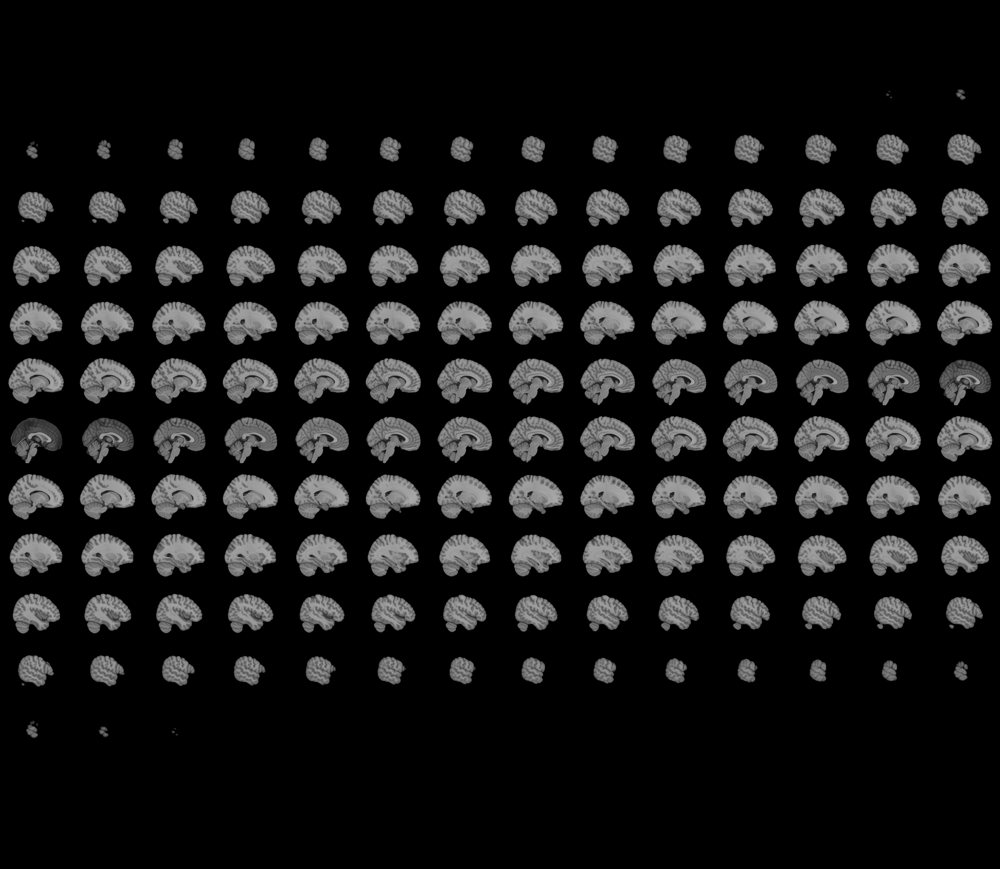
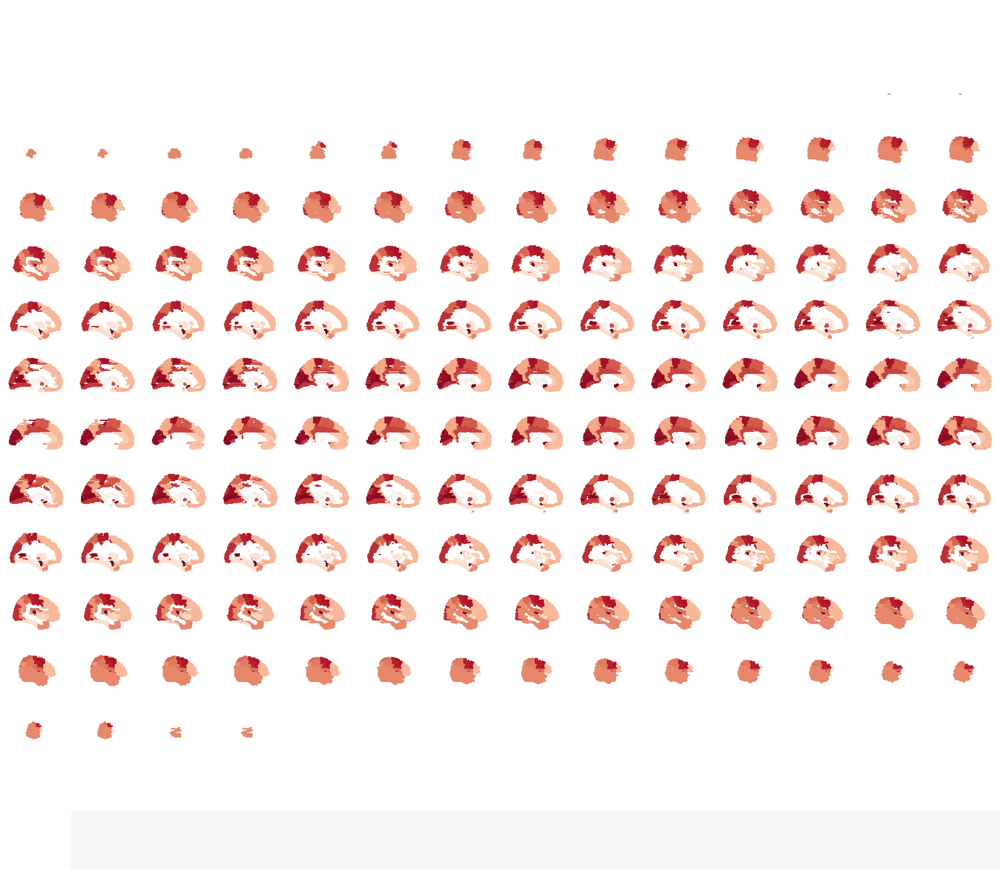

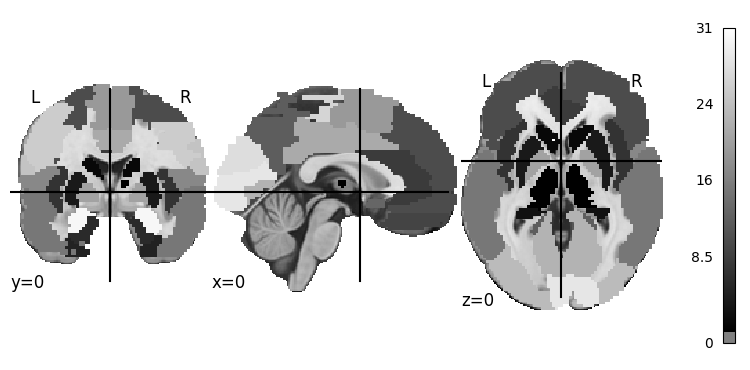

In [29]:
subtype = list(ordered_biomarkers.keys())[1]  # pick one, or loop over all
order_list = ordered_biomarkers[subtype]

order_list = [label.replace('SUVr_', '') for label in order_list ]
rank_img = build_rank_img(order_list, mask_dir, region_groups, target_img=mni)


# Plot static orthogonal views with a colorbar (shows rank values)
plot = plotting.plot_img(
    rank_img,
    bg_img=mni,
    display_mode="ortho",
    cut_coords=(0, 0, 0),  # adjust to taste
    threshold=0,           # show all positive ranks
    colorbar=True
)

view = plotting.view_img(rank_img, bg_img=mni)
view  

c:\Users\huw\OneDrive\Documents\Research_Internship\MPhys_scripts\.conda\Lib\site-packages\numpy\core\fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



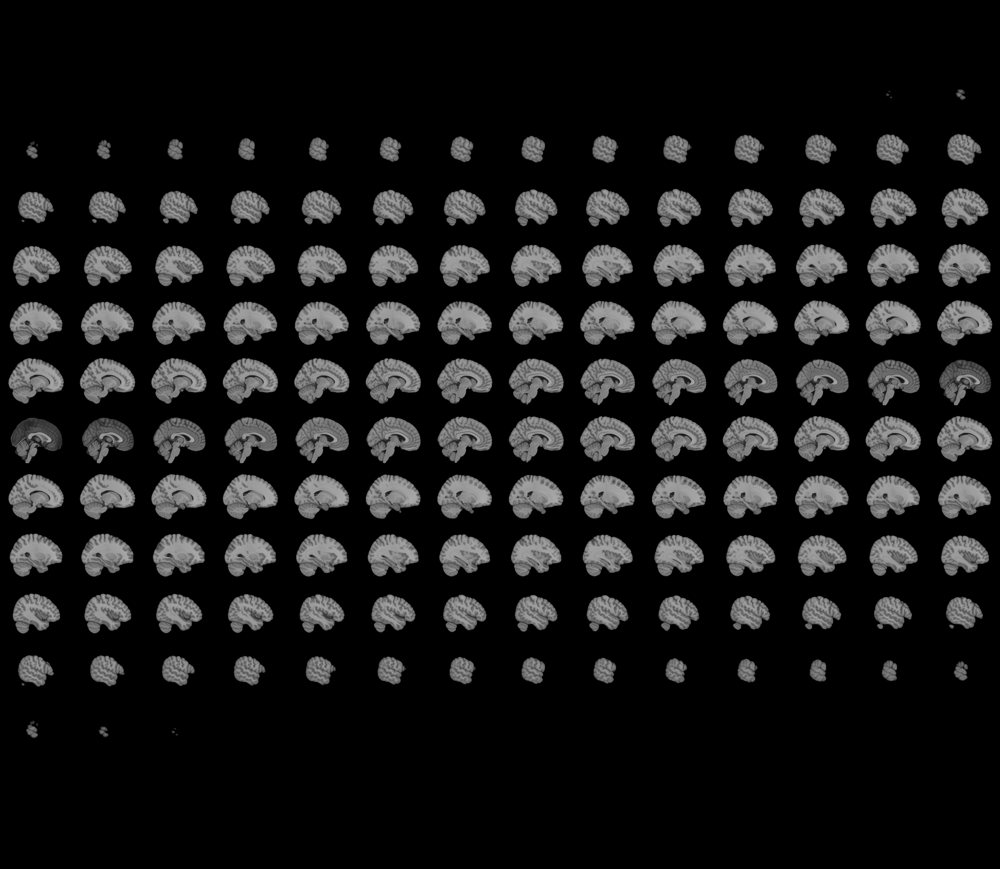
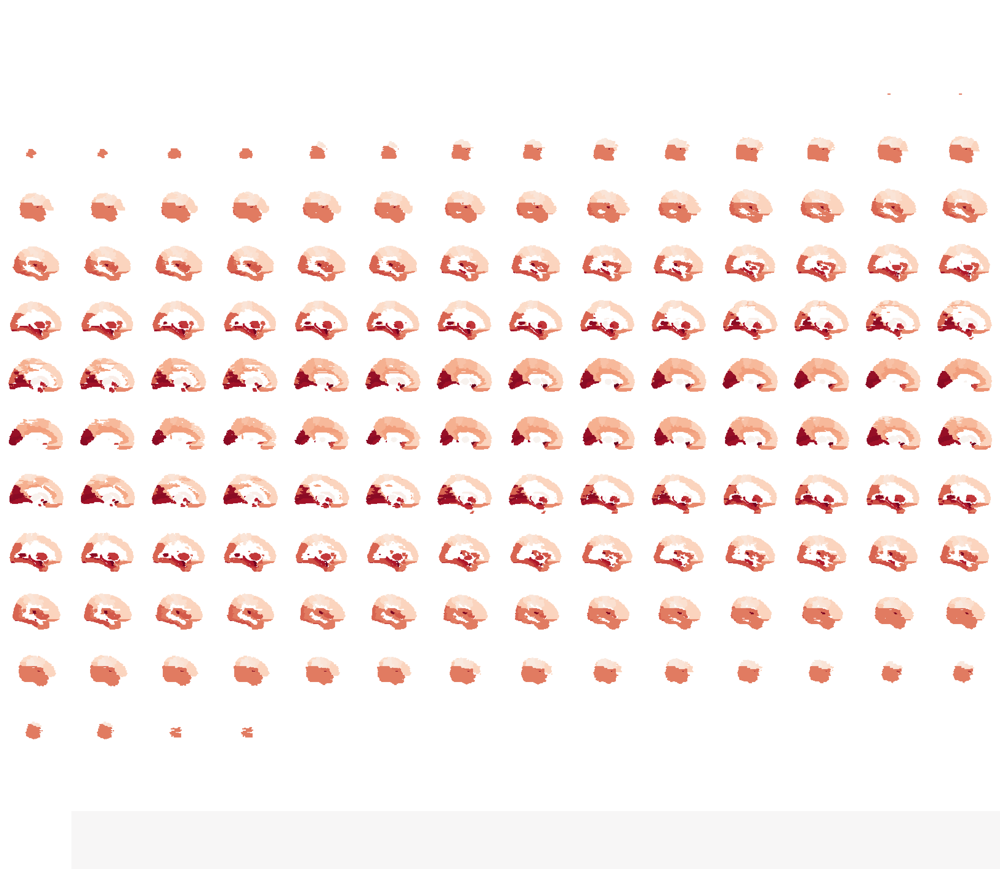

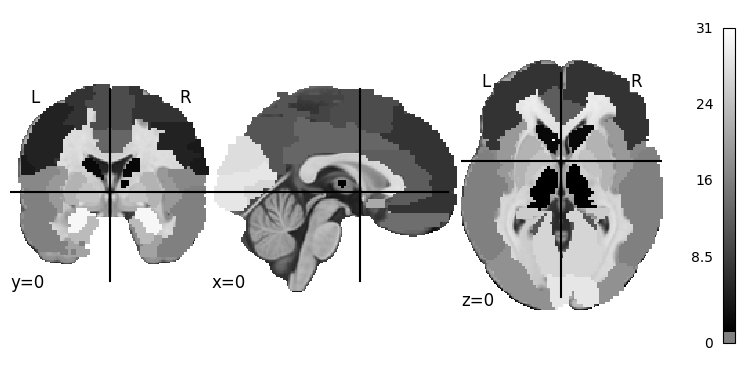

In [30]:
subtype = list(ordered_biomarkers.keys())[2]  # pick one, or loop over all
order_list = ordered_biomarkers[subtype]

order_list = [label.replace('SUVr_', '') for label in order_list ]
rank_img = build_rank_img(order_list, mask_dir, region_groups, target_img=mni)


# Plot static orthogonal views with a colorbar (shows rank values)
plot = plotting.plot_img(
    rank_img,
    bg_img=mni,
    display_mode="ortho",
    cut_coords=(0, 0, 0),  # adjust to taste
    threshold=0,           # show all positive ranks
    colorbar=True
)

view = plotting.view_img(rank_img, bg_img=mni)
view  

## Analysis

<Axes: xlabel='ml_subtype'>

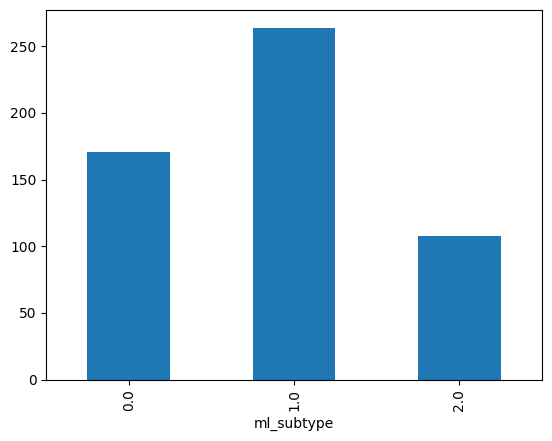

In [31]:
zdata['ml_subtype'].value_counts().sort_index().plot(kind='bar')

In [32]:
zdata

,PTID,TAU_bl,PTAU_bl,ABETA_bl,EXAMDATE,EXAMDATE_bl,DX_bl,DX,AGE,PTGENDER,...,Rectus,Red_Nucleus,Rolandic_Oper,Substantia_Nigra,Supplementary_Motor_Area,Supramarginal,Temporal,Thalamus,Vermis,VTA
0,100_S_5280,101.20,10.08,731.8,2015-09-29,2013-09-17,3,2,67.5,0,...,0.043815,0.004161,0.058189,0.002721,0.119471,0.075442,0.118043,0.005287,0.012521,0.000686
1,027_S_5277,324.80,34.39,780.3,2015-08-31,2013-08-28,3,2,71.8,1,...,0.062031,0.004022,0.089905,0.003186,0.177703,0.130432,0.179251,0.005257,0.012040,0.000735
2,135_S_5275,490.40,53.18,832.7,2014-02-25,2013-08-27,0,0,78.0,1,...,0.062906,0.004595,0.084318,0.003165,0.163884,0.110350,0.177427,0.005697,0.013098,0.000782
3,135_S_5269,108.20,10.55,590.4,2015-09-01,2013-08-20,3,2,64.9,0,...,0.046634,0.004011,0.068649,0.002860,0.134892,0.087710,0.133143,0.005788,0.013557,0.000712
4,007_S_5265,247.10,24.78,466.1,2015-08-25,2013-08-12,3,2,75.1,1,...,0.048248,0.003765,0.058848,0.002737,0.127042,0.079074,0.134546,0.004762,0.011835,0.000675
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
538,127_S_5266,279.90,24.28,1700.0,2015-08-06,2013-08-15,3,2,65.9,0,...,0.049342,0.004745,0.066142,0.003171,0.124052,0.075240,0.127367,0.006535,0.013264,0.000791
539,053_S_5272,305.00,25.05,1700.0,2015-09-15,2013-09-04,3,2,69.9,1,...,0.046475,0.003726,0.074981,0.002785,0.162249,0.110294,0.143957,0.005166,0.011958,0.000629
540,053_S_5287,268.40,26.11,1700.0,2015-09-30,2013-09-18,3,2,78.9,1,...,0.049922,0.004474,0.071697,0.003204,0.149064,0.095745,0.137518,0.005365,0.011565,0.000738
541,027_S_5288,300.10,26.59,1700.0,2015-09-24,2013-09-25,3,2,81.9,1,...,0.042460,0.004364,0.062177,0.003059,0.125860,0.089267,0.130894,0.005212,0.011929,0.000791


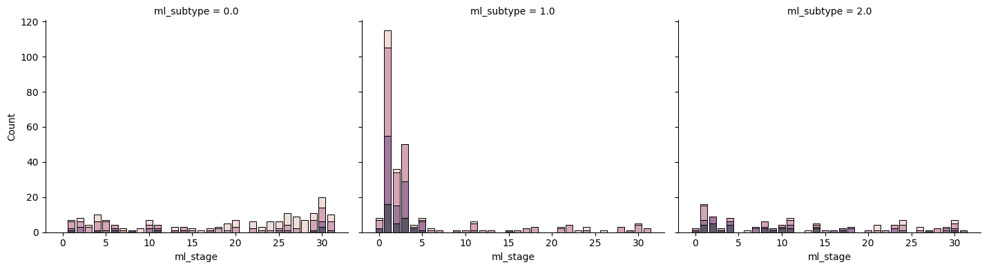

In [33]:
g = sns.FacetGrid(zdata, col="ml_subtype", height=4, aspect=1.2)
g.map_dataframe(sns.histplot, x="ml_stage", hue="DX_bl", multiple="stack", discrete=True, shrink=0.8, legend=True)
g.add_legend()
plt.show()

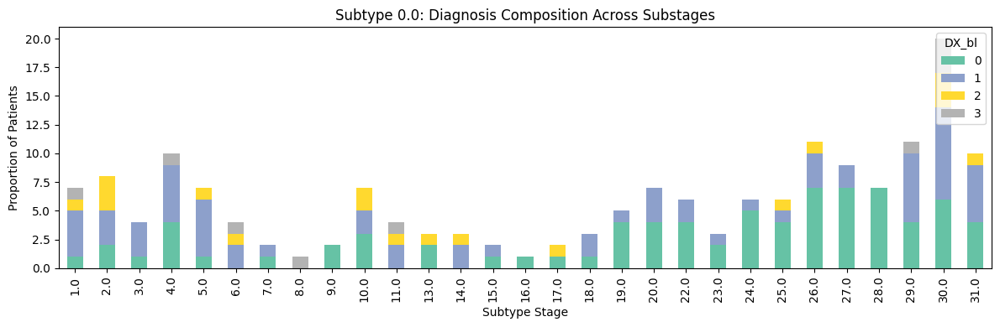

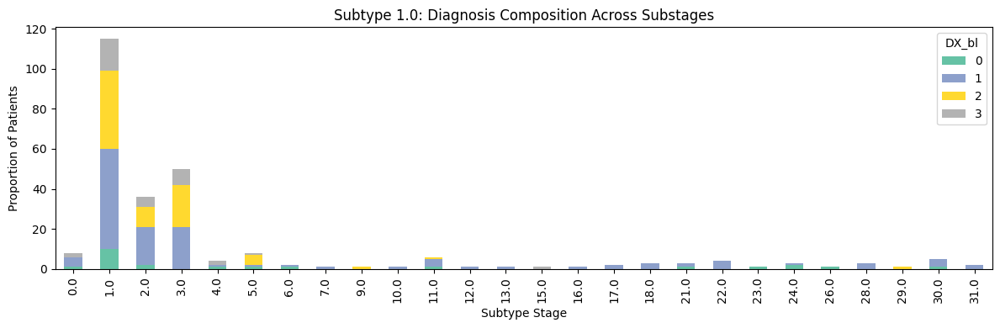

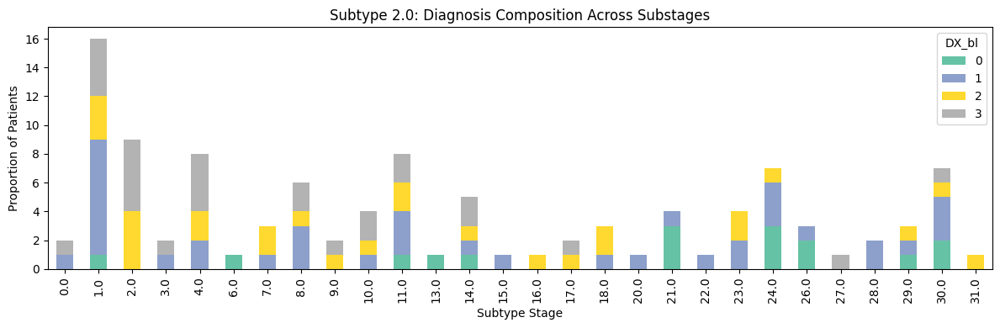

In [34]:
# Create one plot per subtype
for i in sorted(zdata['ml_subtype'].unique()):
    temp_df = zdata[zdata['ml_subtype'] == i]

    # Crosstab: counts of diagnosis per stage
    ctab = pd.crosstab(temp_df['ml_stage'], temp_df['DX_bl'])

    # Normalize to get proportions
    # prop_ctab = ctab.div(ctab.sum(axis=1), axis=0)

    # Plot
    ctab.plot(kind='bar', stacked=True, figsize=(12, 4), colormap='Set2')
    plt.title(f"Subtype {i}: Diagnosis Composition Across Substages")
    plt.xlabel("Subtype Stage")
    plt.ylabel("Proportion of Patients")
    plt.legend(title="DX_bl", loc='upper right')
    plt.tight_layout()
    plt.show()

C:\Users\huw\AppData\Local\Temp\ipykernel_36380\1559029128.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['DX_bl'] = temp_df['DX_bl'].map(dx_map)
C:\Users\huw\AppData\Local\Temp\ipykernel_36380\1559029128.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


Subtype: 0.0
DX_bl
AD     0.487654
MCI    0.401235
CN     0.111111
Name: proportion, dtype: float64
DX_bl
AD     79
MCI    65
CN     18
Name: count, dtype: int64


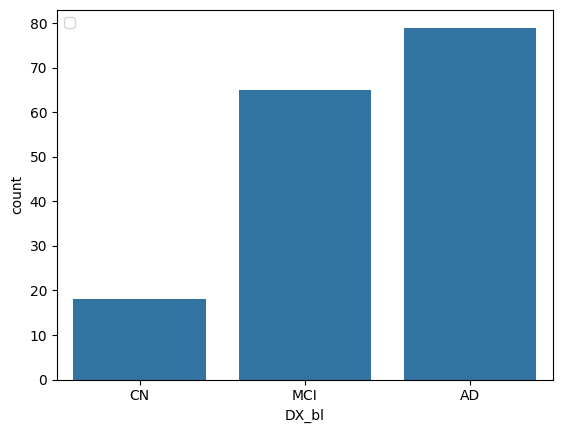

Subtype: 1.0
DX_bl
MCI    0.558952
CN     0.340611
AD     0.100437
Name: proportion, dtype: float64
DX_bl
MCI    128
CN      78
AD      23
Name: count, dtype: int64


C:\Users\huw\AppData\Local\Temp\ipykernel_36380\1559029128.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['DX_bl'] = temp_df['DX_bl'].map(dx_map)
C:\Users\huw\AppData\Local\Temp\ipykernel_36380\1559029128.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


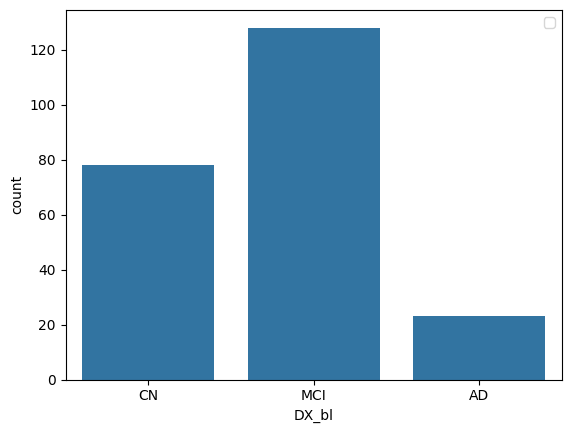

C:\Users\huw\AppData\Local\Temp\ipykernel_36380\1559029128.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['DX_bl'] = temp_df['DX_bl'].map(dx_map)
C:\Users\huw\AppData\Local\Temp\ipykernel_36380\1559029128.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


Subtype: 2.0
DX_bl
MCI    0.469136
CN     0.333333
AD     0.197531
Name: proportion, dtype: float64
DX_bl
MCI    38
CN     27
AD     16
Name: count, dtype: int64


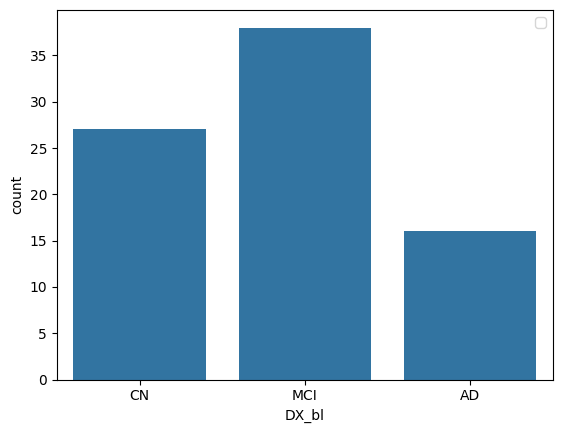

In [35]:
for i in sorted(zdata['ml_subtype'].unique()):
    dx_map = {0.0: 'AD',
              1.0: 'MCI',
              2.0: 'CN'}
    temp_df = zdata[zdata['ml_subtype'] == i]
    temp_df['DX_bl'] = temp_df['DX_bl'].map(dx_map)
    print(f'Subtype: {i}')
    print(temp_df['DX_bl'].value_counts(normalize = True))
    print(temp_df['DX_bl'].value_counts(normalize = False))
    sns.countplot(temp_df, x = 'DX_bl', order=['CN', 'MCI', 'AD'])
    plt.legend()
    plt.show()

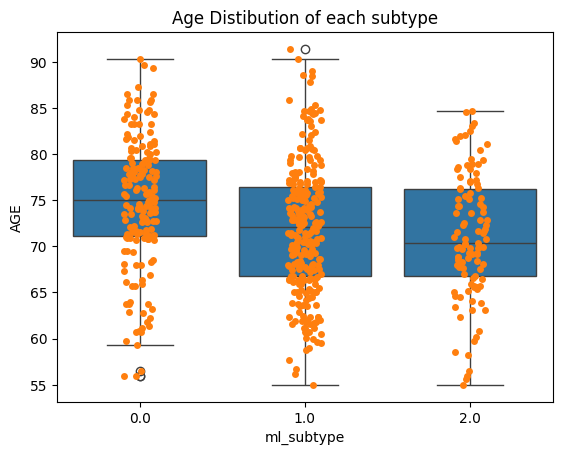

Subtype: 0.0
74.78538011695908
7.101190227615285
Subtype: 1.0
71.9310606060606
7.067777602589016
Subtype: 2.0
71.06018518518519
6.778042336051847


In [36]:
sns.boxplot(zdata, x = 'ml_subtype', y = 'AGE')
sns.stripplot(zdata, x = 'ml_subtype', y = 'AGE')
plt.title('Age Distibution of each subtype')
plt.show()

for i in sorted(zdata['ml_subtype'].unique()):
    sub = zdata[zdata['ml_subtype'] == i]
    print(f'Subtype: {i}')
    print(sub['AGE'].mean())
    print(sub['AGE'].std())

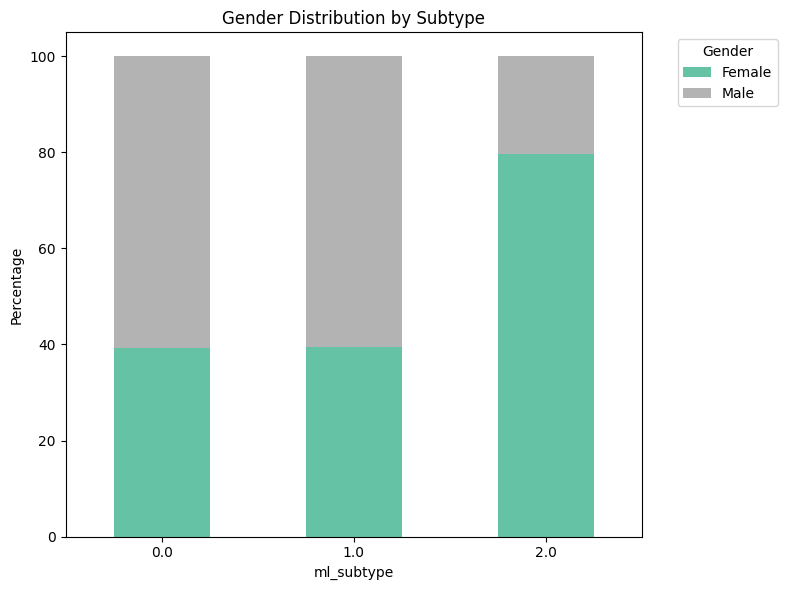

PTGENDER       Female       Male
ml_subtype                      
0.0         39.181287  60.818713
1.0         39.393939  60.606061
2.0         79.629630  20.370370
Chi-squared test statistic: 56.423
Degrees of freedom: 2
p-value: 5.597160236078137e-13


In [37]:
from scipy.stats import chi2_contingency
gender_map = {0: 'Male', 1: 'Female'}
zdata['PTGENDER'] = zdata['PTGENDER'].map(gender_map)

gender_counts = zdata.groupby(['ml_subtype', 'PTGENDER']).size().unstack(fill_value=0)
gender_percent = gender_counts.div(gender_counts.sum(axis=1), axis=0) * 100
ax = gender_percent.plot(kind='bar', stacked=True, figsize=(8, 6), colormap='Set2')

plt.ylabel('Percentage')
plt.title('Gender Distribution by Subtype')
plt.legend(title='Gender', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

print(gender_percent)

chi2, p, dof, expected = chi2_contingency(gender_counts.values)

print("Chi-squared test statistic:", round(chi2, 3))
print("Degrees of freedom:", dof)
print("p-value:", p)

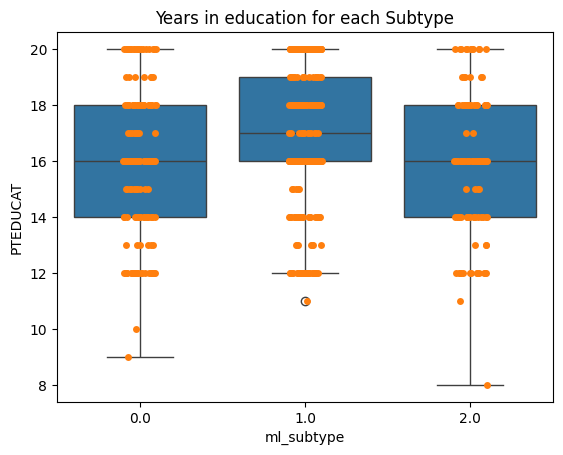

Subtype: 0.0
16.035087719298247
2.5779488810751334
Subtype: 1.0
16.696969696969695
2.545224093727537
Subtype: 2.0
15.944444444444445
2.5934256684584804


In [38]:
sns.boxplot(zdata, x = 'ml_subtype', y = 'PTEDUCAT')
sns.stripplot(zdata, x = 'ml_subtype', y = 'PTEDUCAT')
plt.title('Years in education for each Subtype')
plt.show()

for i in sorted(zdata['ml_subtype'].unique()):
    sub = zdata[zdata['ml_subtype'] == i]
    print(f'Subtype: {i}')
    print(sub['PTEDUCAT'].mean())
    print(sub['PTEDUCAT'].std())

In [39]:
zdata

,PTID,TAU_bl,PTAU_bl,ABETA_bl,EXAMDATE,EXAMDATE_bl,DX_bl,DX,AGE,PTGENDER,...,Rectus,Red_Nucleus,Rolandic_Oper,Substantia_Nigra,Supplementary_Motor_Area,Supramarginal,Temporal,Thalamus,Vermis,VTA
0,100_S_5280,101.20,10.08,731.8,2015-09-29,2013-09-17,3,2,67.5,Male,...,0.043815,0.004161,0.058189,0.002721,0.119471,0.075442,0.118043,0.005287,0.012521,0.000686
1,027_S_5277,324.80,34.39,780.3,2015-08-31,2013-08-28,3,2,71.8,Female,...,0.062031,0.004022,0.089905,0.003186,0.177703,0.130432,0.179251,0.005257,0.012040,0.000735
2,135_S_5275,490.40,53.18,832.7,2014-02-25,2013-08-27,0,0,78.0,Female,...,0.062906,0.004595,0.084318,0.003165,0.163884,0.110350,0.177427,0.005697,0.013098,0.000782
3,135_S_5269,108.20,10.55,590.4,2015-09-01,2013-08-20,3,2,64.9,Male,...,0.046634,0.004011,0.068649,0.002860,0.134892,0.087710,0.133143,0.005788,0.013557,0.000712
4,007_S_5265,247.10,24.78,466.1,2015-08-25,2013-08-12,3,2,75.1,Female,...,0.048248,0.003765,0.058848,0.002737,0.127042,0.079074,0.134546,0.004762,0.011835,0.000675
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
538,127_S_5266,279.90,24.28,1700.0,2015-08-06,2013-08-15,3,2,65.9,Male,...,0.049342,0.004745,0.066142,0.003171,0.124052,0.075240,0.127367,0.006535,0.013264,0.000791
539,053_S_5272,305.00,25.05,1700.0,2015-09-15,2013-09-04,3,2,69.9,Female,...,0.046475,0.003726,0.074981,0.002785,0.162249,0.110294,0.143957,0.005166,0.011958,0.000629
540,053_S_5287,268.40,26.11,1700.0,2015-09-30,2013-09-18,3,2,78.9,Female,...,0.049922,0.004474,0.071697,0.003204,0.149064,0.095745,0.137518,0.005365,0.011565,0.000738
541,027_S_5288,300.10,26.59,1700.0,2015-09-24,2013-09-25,3,2,81.9,Female,...,0.042460,0.004364,0.062177,0.003059,0.125860,0.089267,0.130894,0.005212,0.011929,0.000791


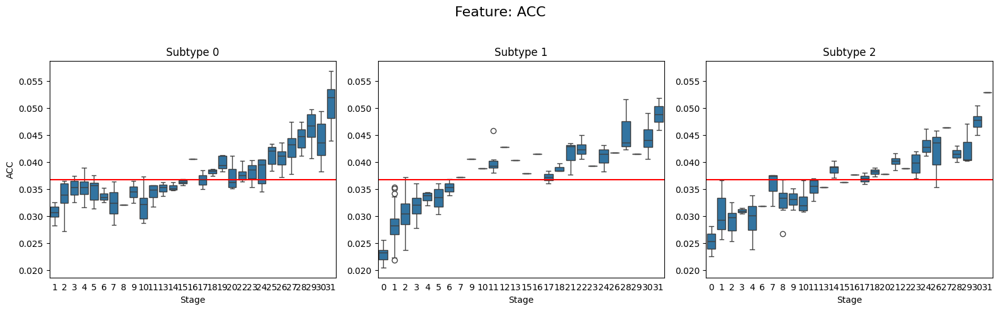

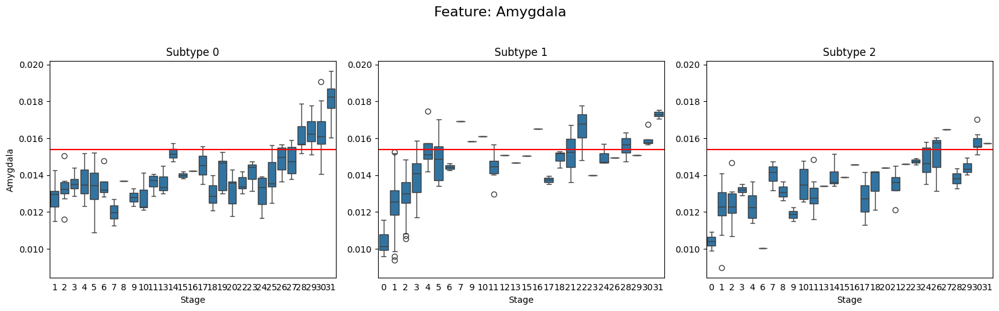

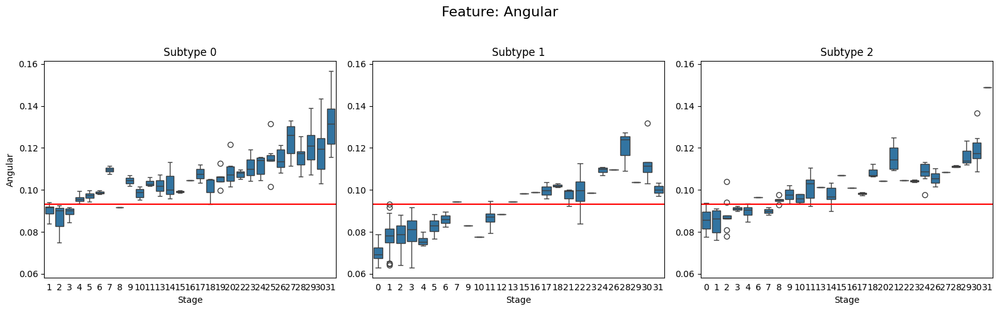

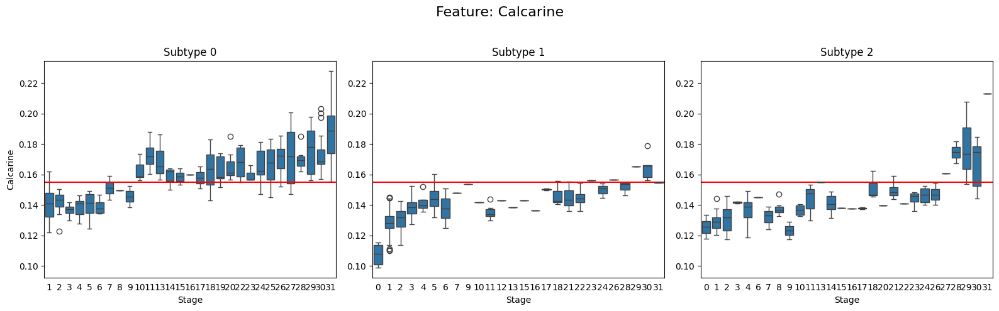

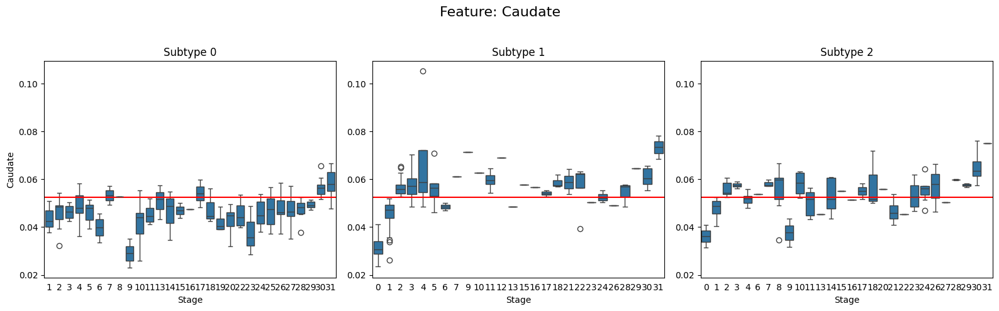

...

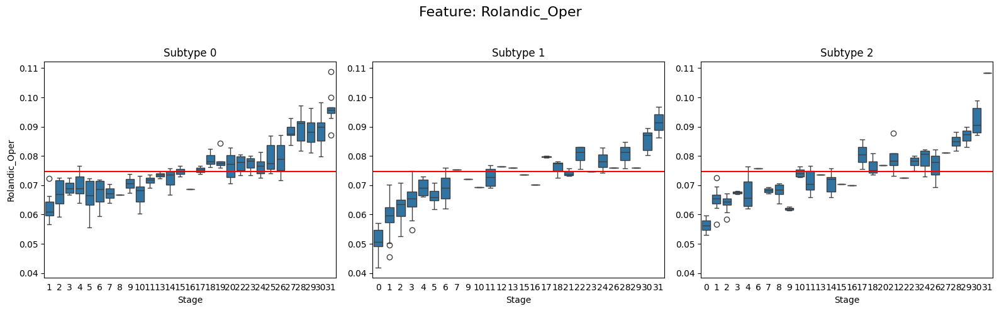

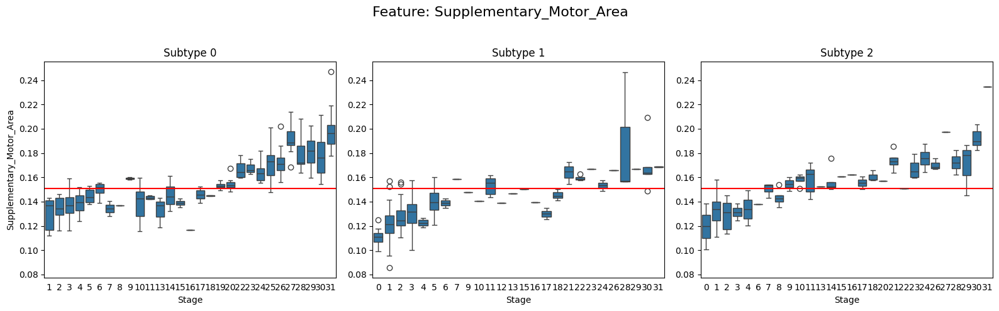

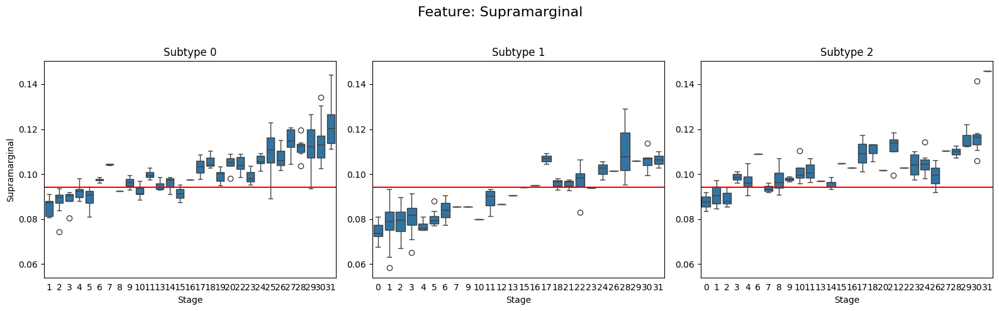

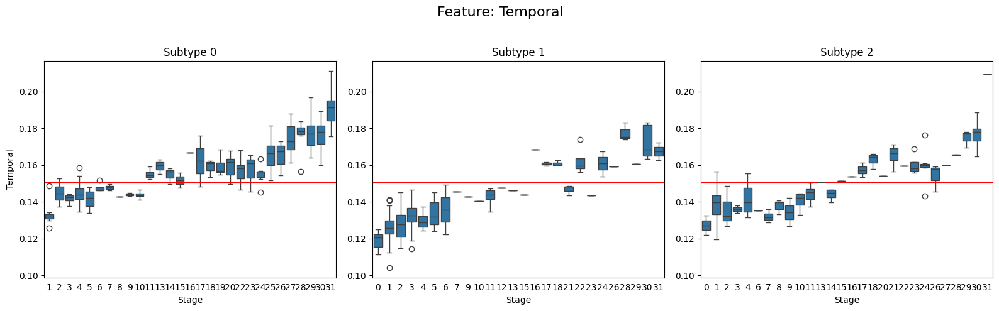

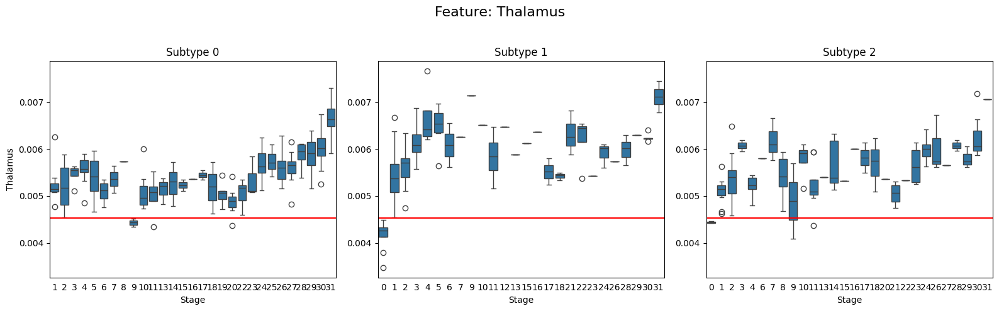

In [50]:
from torch import threshold


subtypes = [0, 1, 2]
features_to_view = sorted(SuStaInLabels)
for feature in features_to_view:
    fig, axs = plt.subplots(nrows=1, ncols=len(subtypes), figsize=(16, 5), sharey=True)
    fig.suptitle(f'Feature: {feature}', fontsize=16)

    for idx, subtype in enumerate(subtypes):
        sub = zdata[zdata['ml_subtype'] == subtype].copy()
        sub['ml_stage'] = sub['ml_stage'].astype(int)
        sns.boxplot(data=sub, x='ml_stage', y=feature, ax=axs[idx])
        axs[idx].set_title(f'Subtype {subtype}')
        axs[idx].set_xlabel('Stage')
        axs[idx].set_ylabel(feature)
        axs[idx].tick_params(top=False, bottom=False, left=True, right=False,
                labelleft=True, labelbottom=True)
        axs[idx].axhline(gmm_means[feature]['threshold'], color = 'Red', label = 'Normal/ABnormal Threshold')
        

    plt.tight_layout(rect=[0, 0, 1, 0.95])  
    plt.show()

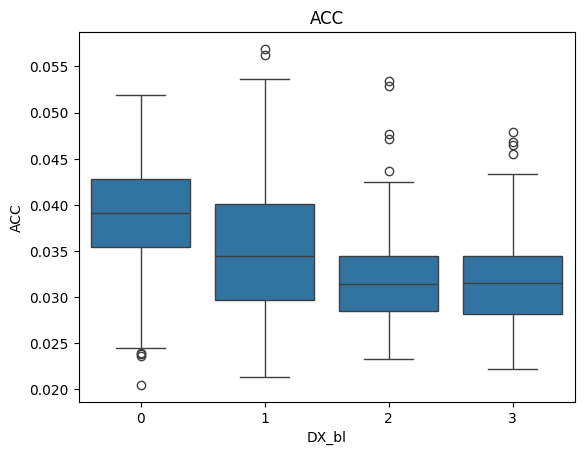

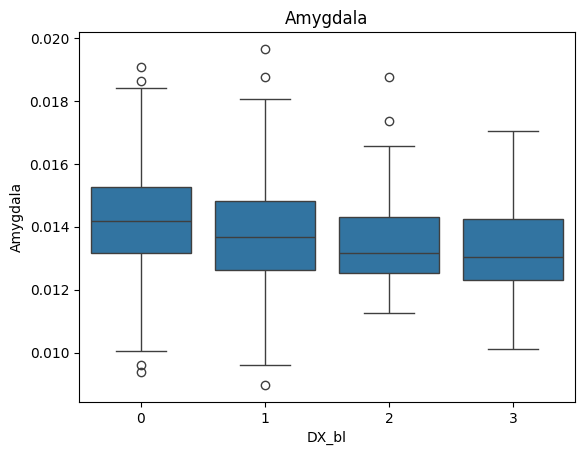

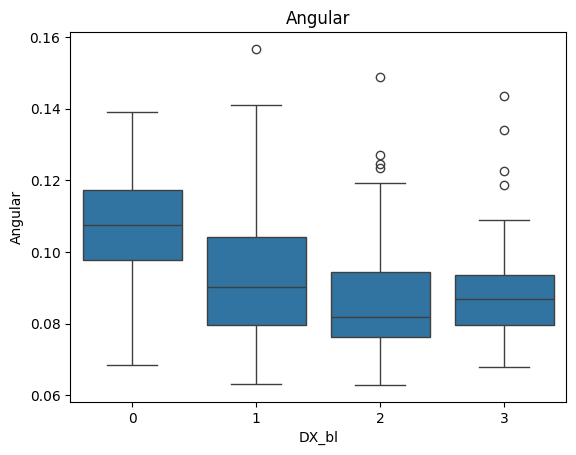

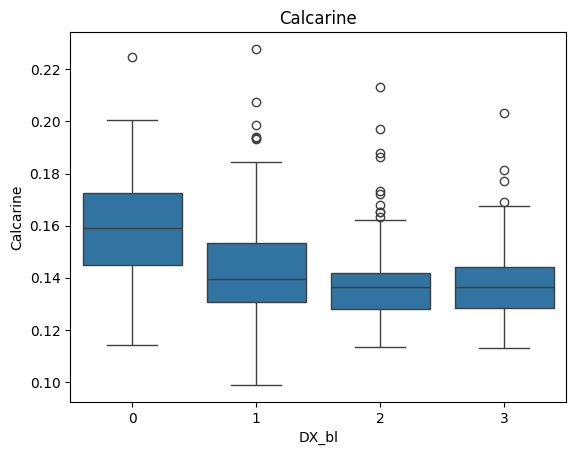

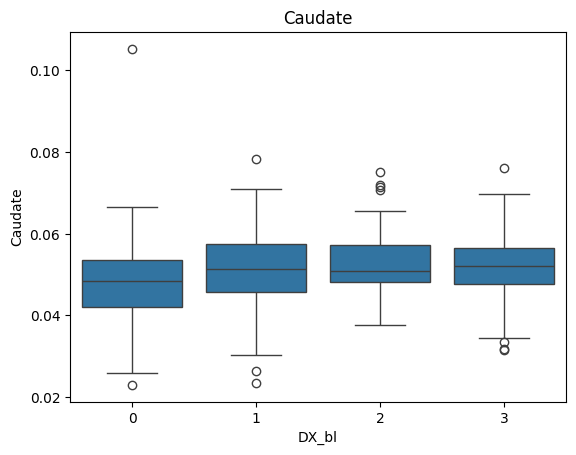

...

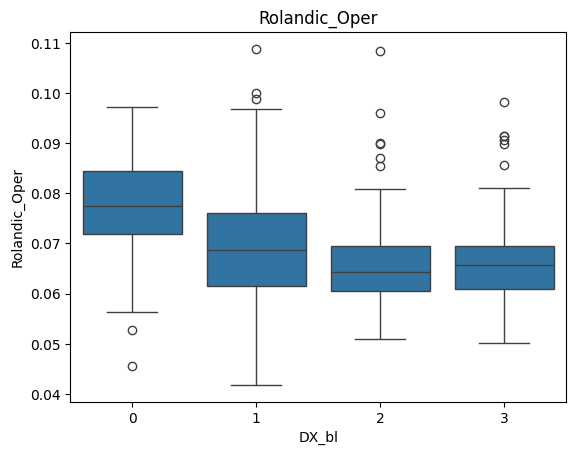

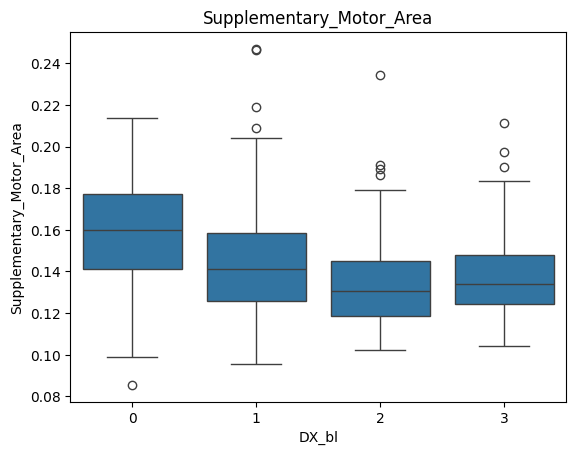

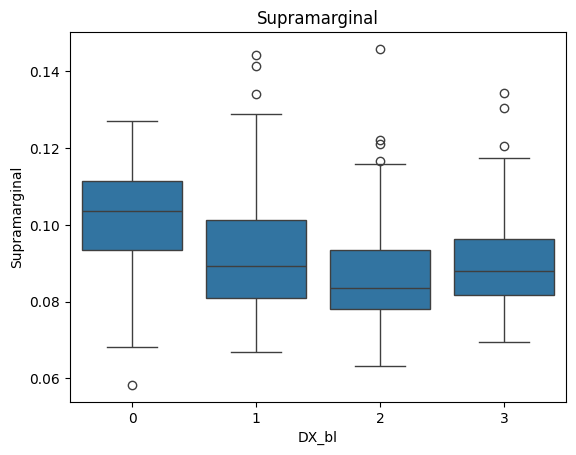

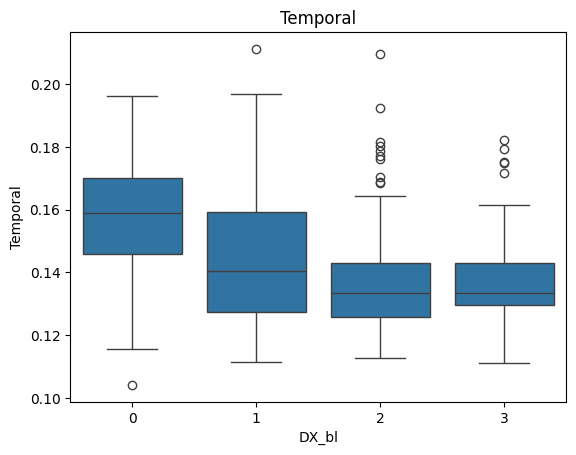

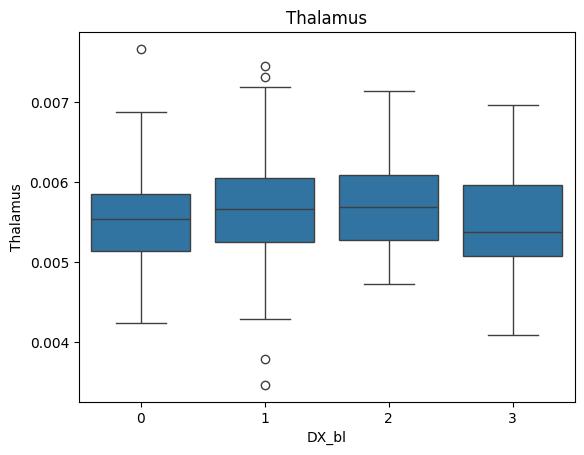

In [57]:
features_to_view = sorted(SuStaInLabels)    
for i in features_to_view:    
    sns.boxplot(zdata, x = 'DX_bl', y = i)
    plt.title(i)
    plt.show()

[]

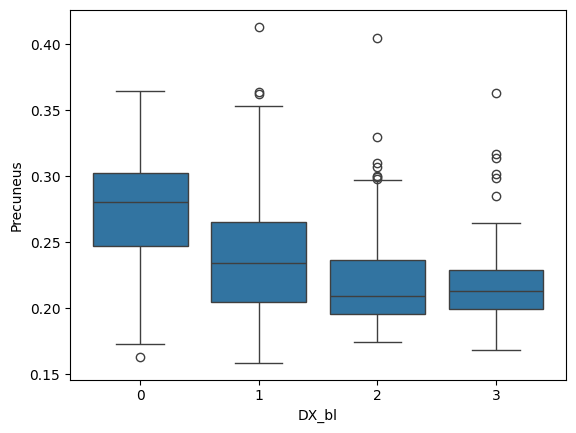